In [1]:
import sys
import numpy as np
import cv2
import theano
import keras
import glob

from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers.convolutional import Conv2D, MaxPooling2D
from keras.utils import np_utils
from matplotlib import pyplot as plt

np.random.seed(123)

print "Python version: ", sys.version
print "OpenCV version: ", cv2.__version__
print "Theano version: ",theano.__version__
print "keras version: ", keras.__version__

# Comandos para instalação das bibliotecas
# 1° pip install keras
# 2° pip install --upgrade keras
# 3° conda install theano pygpu 
# 4° mudar backend para theano no arquivo keras.json:
#        caminho linux: $HOME/.keras/keras.json
#        caminho windows: %USERPROFILE%/.keras/keras.json
#
# fontes: https://elitedatascience.com/keras-tutorial-deep-learning-in-python
#         http://deeplearning.net/software/theano/install_windows.html#stable-installation
#         https://keras.io/backend/


Using Theano backend.


Python version:  2.7.13 |Anaconda 4.4.0 (64-bit)| (default, May 11 2017, 13:17:26) [MSC v.1500 64 bit (AMD64)]
OpenCV version:  3.3.0
Theano version:  0.9.0.dev-c697eeab84e5b8a74908da654b66ec9eca4f1291
keras version:  2.1.2


In [2]:
#classe para carregar, cortar as imagens e montar o database para o keras
class Helper:    
    def __init__(self,link,largura,altura):
        self.largura = largura
        self.altura = altura
        self.link = link
        self.local_treino = "treinamento/*.jpg"
        self.local_validacao = "validacao/*.jpg"
        self.local_labels = "labels10k/"
        self.local_teste = "teste/*.jpg"
        self.map = [['0',0],['1',1],['2',2],['3',3],['4',4],['5',5],['6',6],['7',7],['8',8],['9',9],['A',10],
                    ['B',11],['C',12],['D',13],['E',14],['F',15],['G',16],['H',17],['I',18],['J',19],['K',20],['L',21],
                    ['M',22],['N',23],['O',24],['P',25],['Q',26],['R',27],['S',28],['T',29],['U',30],['V',31],['W',32],
                    ['X',33],['Y',34],['Z',35]]
    
    #carrega as imagens. Retorna o vetor de imagens separadas por letra e o vetor de labels
    def carrega_data(self,local):
        #verifica quais imagens carregar: imagens de treino, de validação ou teste
        if local == 'treinamento':
            arquivos = glob.glob(self.link+self.local_treino)
            print "carregando as imagens de treinamentos"
            print "link dos arquivos:" + self.link+self.local_treino
        elif local == 'validacao':
            arquivos = glob.glob(self.link+self.local_validacao)
            print "carregando as imagens de validação"
            print "link dos arquivos:" + self.link+self.local_validacao
        else :
            arquivos = glob.glob(self.link+self.local_teste)
            print "carregando as imagens de teste"
            print "link dos arquivos:" + self.link+self.local_teste
            
        labels = self.link+self.local_labels
        print "link dos labels:" + str(labels)
        
        img_data = []
        label_data = []
        for imagens in arquivos:
            #carrega e corta a imagem
            img = cv2.imread(imagens,0)
            img = img[5:-5, 12:]
            partes = self.corte_imagem(img)
            
            #carrega o label da imagem
            label = open(str(labels)+str(imagens[-10:-4])+".txt","r")
            linha = label.readline()
            label.close()
            
            #atualiza o vetor de imagens e o de labels
            for x in range(6):
                partes[x] = np.array(partes[x])
                img_data.append(partes[x])
                if ord(linha[x]) < ord('A') :
                    label_data.append(ord(linha[x])-ord('0'))
                else:
                    label_data.append(ord(linha[x])-55)
                
        print "fim do carregamento"
        print "------------------------------------------"
        return np.array(img_data),np.array(label_data)
    
    #corta a imagem em 6 partes
    def corte_imagem(self,imagem):
        x_ini = 0
        x_fim = int(imagem.shape[1]/6)
        largura = x_fim
        imgs = []
        for x in range(6):
            aux = imagem[:,x_ini:x_fim]
            aux = cv2.resize(aux,(self.largura,self.altura))
            imgs.append(aux)
            x_ini = x_fim
            x_fim += largura
        return imgs   

In [3]:
#carrega imagens de treino e validaçao
helper = Helper("./dados/CAPTCHA-10k/",largura = 30, altura = 50)
(X_train, y_train) = helper.carrega_data("treinamento")
(X_vali, y_vali) = helper.carrega_data("validacao")

carregando as imagens de treinamentos
link dos arquivos:./dados/CAPTCHA-10k/treinamento/*.jpg
link dos labels:./dados/CAPTCHA-10k/labels10k/
fim do carregamento
------------------------------------------
carregando as imagens de validação
link dos arquivos:./dados/CAPTCHA-10k/validacao/*.jpg
link dos labels:./dados/CAPTCHA-10k/labels10k/
fim do carregamento
------------------------------------------


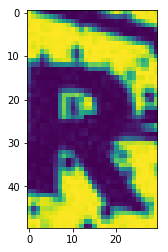

class ID:R


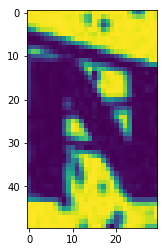

class ID:N


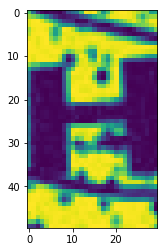

class ID:H


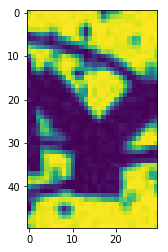

class ID:Y


In [4]:
plt.imshow(X_train[0])
plt.show()
print "class ID:"+(helper.map[y_train[0]][0])

plt.imshow(X_train[1])
plt.show()
print "class ID:"+(helper.map[y_train[1]][0])

plt.imshow(X_vali[0])
plt.show()
print "class ID:"+(helper.map[y_vali[0]][0])

plt.imshow(X_vali[1])
plt.show()
print "class ID:"+(helper.map[y_vali[1]][0])

In [5]:
#Formatando os dados
X_train = X_train.reshape(X_train.shape[0], helper.largura, helper.altura,1)
X_vali = X_vali.reshape(X_vali.shape[0], helper.largura, helper.altura,1)

X_train = np.array(X_train, dtype=np.float32)
X_vali = np.array(X_vali, dtype=np.float32)

X_train /= 255
X_vali /= 255
print len(y_train)
print y_train[:10]
print X_train.shape

48000
[27 23 18 23 18 12 29 31 12 15]
(48000L, 30L, 50L, 1L)


In [6]:
# Alterando o numero de classes
Y_train = np_utils.to_categorical(y_train, 36)
Y_vali = np_utils.to_categorical(y_vali, 36)

del y_train
del y_vali

print Y_train.shape
print X_train[0].shape

(48000L, 36L)
(30L, 50L, 1L)


<h2>Arquitetura</h2>

In [7]:
# Sequential layer
model = Sequential()

# CNN input layer
model.add(Conv2D(10, (3, 3), strides=(1, 1), activation='relu', padding='same', input_shape=(helper.largura,helper.altura,1)))

# hiden layers
model.add(Conv2D(10, (3, 3), padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2), padding='same'))
model.add(Dropout(0.25))

# fully connected layer
model.add(Flatten())
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(36, activation='softmax'))

model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 30, 50, 10)        100       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 30, 50, 10)        910       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 15, 25, 10)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 15, 25, 10)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 3750)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                120032    
_________________________________________________________________
dropout_2 (Dropout)          (None, 32)                0         
__________

<h2>Treino</h2>

In [8]:
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
response = model.fit(X_train, Y_train, 
          batch_size=128, epochs=10, verbose=1,validation_data = (X_vali, Y_vali))

Train on 48000 samples, validate on 6000 samples
Epoch 1/10
48000/48000 [==============================] - 108s 2ms/step - loss: 2.9559 - acc: 0.1559 - val_loss: 1.8445 - val_acc: 0.5695
Epoch 2/10
48000/48000 [==============================] - 106s 2ms/step - loss: 2.3305 - acc: 0.2729 - val_loss: 1.3946 - val_acc: 0.6692
Epoch 3/10
48000/48000 [==============================] - 108s 2ms/step - loss: 2.1091 - acc: 0.3224 - val_loss: 1.1903 - val_acc: 0.7030
Epoch 4/10
48000/48000 [==============================] - 107s 2ms/step - loss: 2.0155 - acc: 0.3430 - val_loss: 1.0740 - val_acc: 0.7312
Epoch 5/10
48000/48000 [==============================] - 107s 2ms/step - loss: 1.9467 - acc: 0.3593 - val_loss: 1.0645 - val_acc: 0.7347
Epoch 6/10
48000/48000 [==============================] - 107s 2ms/step - loss: 1.9019 - acc: 0.3731 - val_loss: 0.9450 - val_acc: 0.7532
Epoch 7/10
48000/48000 [==============================] - 108s 2ms/step - loss: 1.8437 - acc: 0.3834 - val_loss: 0.9373 - v

<h2>Teste</h2>

In [9]:
del X_train
del Y_train
del X_vali
del Y_vali

#roda as amostras de teste
(X_test,y_test) = helper.carrega_data("teste")
X_test = X_test.reshape(X_test.shape[0], helper.largura, helper.altura,1)
X_test = np.array(X_test, dtype=np.float32)
X_test /= 255

prediction = model.predict_classes(X_test)
del X_test

print "prediction"+str(prediction)
print "teste"+str(y_test)

carregando as imagens de teste
link dos arquivos:./dados/CAPTCHA-10k/teste/*.jpg
link dos labels:./dados/CAPTCHA-10k/labels10k/
fim do carregamento
------------------------------------------
prediction[19 31  4 ...,  1 35 30]
teste[19 32  4 ...,  1 35 30]


<h2>Resultados</h2>

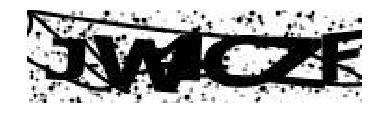

J V 4 C Z F 



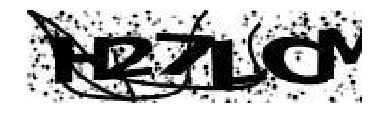

H 2 7 L C M 



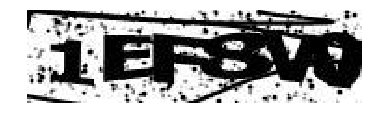

1 E F 8 V 9 



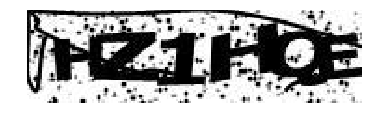

H Z 1 H Q E 



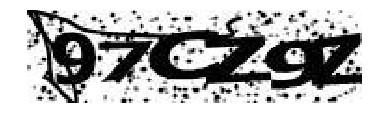

9 7 C Z 9 Z 



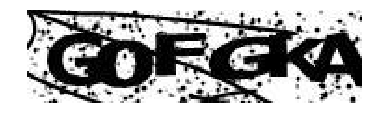

G 0 F G K A 



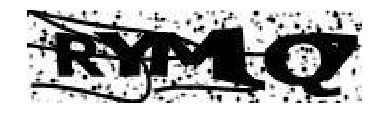

R Y M 1 Q 7 



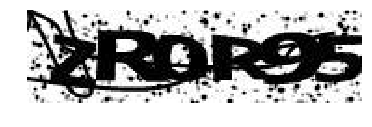

Z R 0 R 9 5 



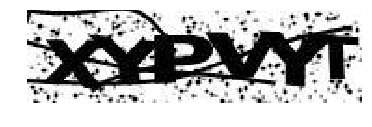

Y Y P V Y T 



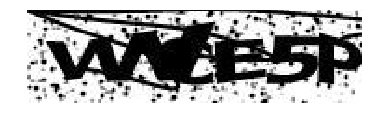

V V Y E 5 P 



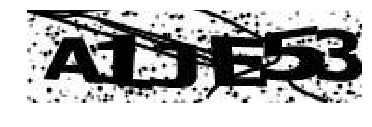

A 1 J 6 5 3 



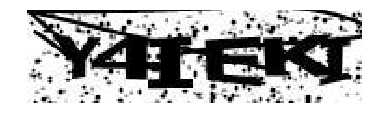

Y 4 I E K T 



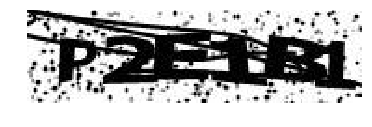

P 2 E 1 B 1 



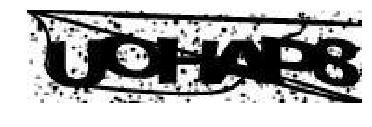

U O H A P B 



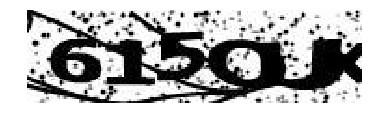

6 1 5 C L X 



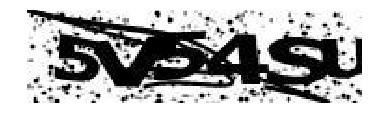

S V 5 4 S U 



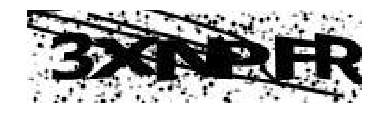

3 X N P T R 



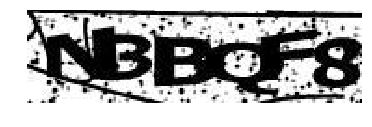

N E B Q F 8 



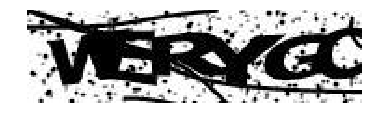

V 5 R Y O O 



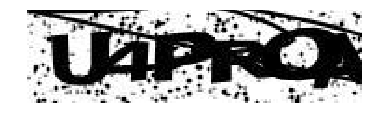

U 4 P R C A 



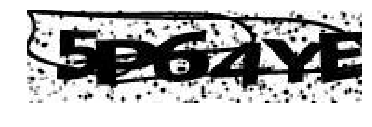

S P 6 X Y E 



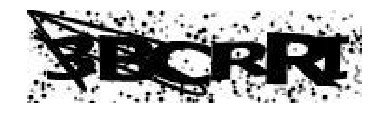

9 2 C R R I 



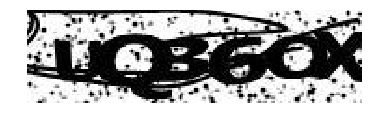

U Q 8 6 O K 



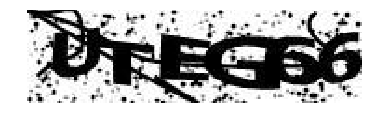

U T E G 6 6 



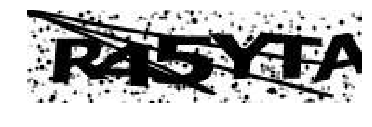

R 4 5 Y T A 



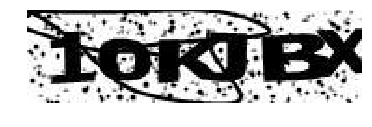

1 0 K J E X 



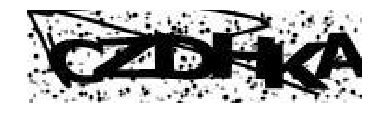

C Z D H K A 



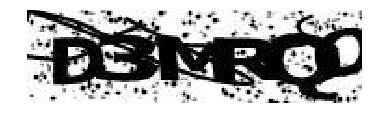

D 3 M F Q I 



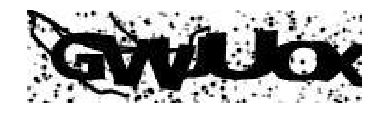

G V V U Q X 



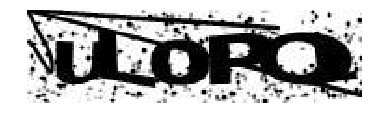

U L 0 P C 1 



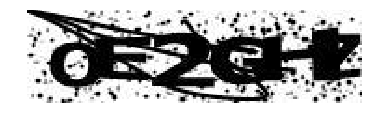

O E 2 G H D 



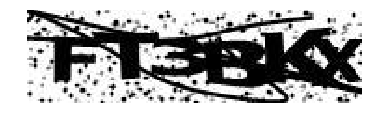

F T 3 B K X 



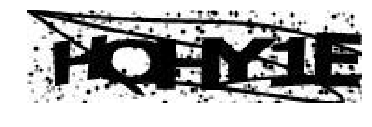

N O H Y 1 E 



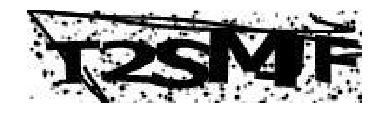

T 2 S N J F 



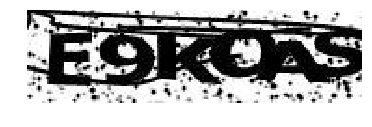

E 9 K C A S 



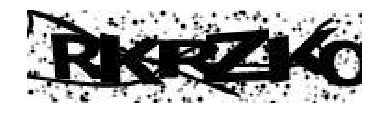

R K R Z K O 



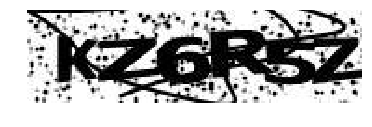

K Z 6 R 5 2 



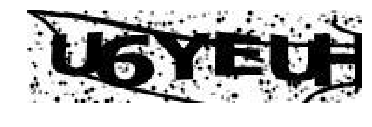

U 6 Y E U H 



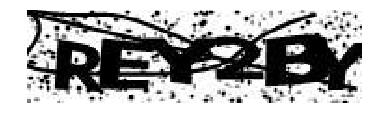

A E Y Z E Y 



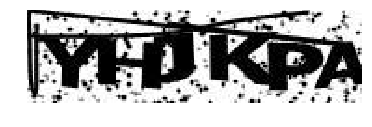

Y H J K X A 



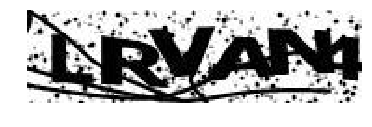

L R V 4 A 4 



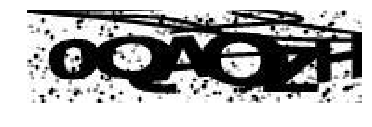

0 Q A C 9 H 



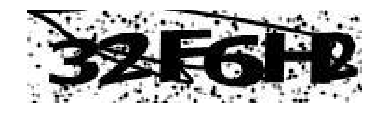

3 2 F 6 H D 



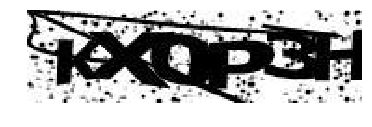

K X 0 F O H 



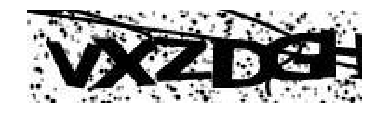

V X Z C G H 



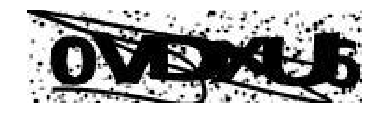

0 V D X L 5 



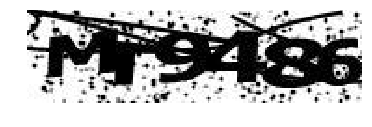

M Y 9 4 5 6 



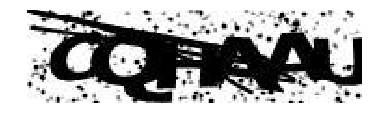

O O R A A U 



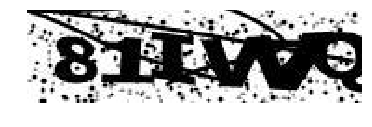

8 1 I V B Q 



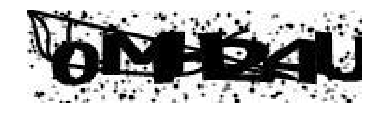

0 M M 2 4 U 



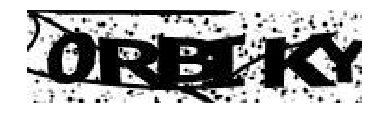

0 R B I K Y 



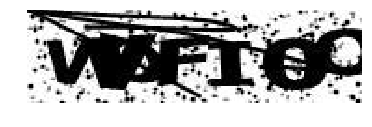

V W F I Q O 



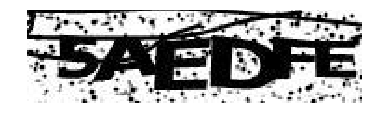

5 A E D F E 



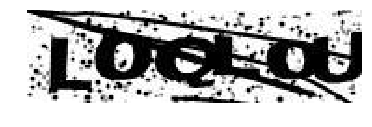

L 0 G U Q U 



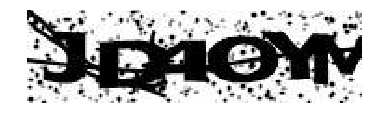

J O A C N M 



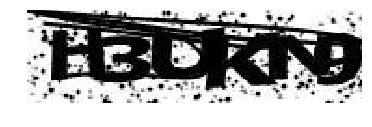

K 3 D K M 9 



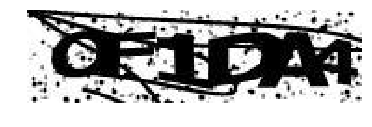

O F 1 O B 4 



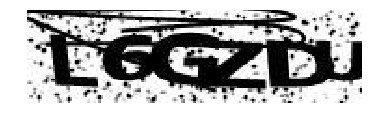

L 6 G Z I U 



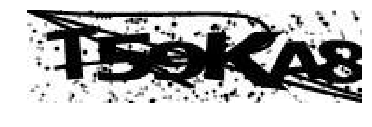

T 5 9 K X 8 



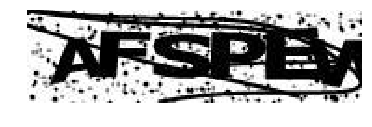

A F S R B V 



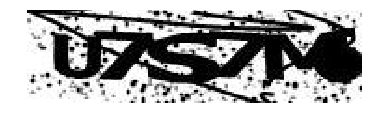

U 7 S 7 N A 



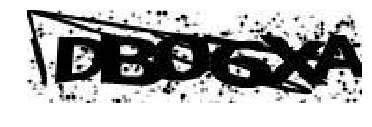

D B 0 6 X A 



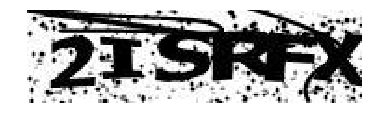

2 I S R F X 



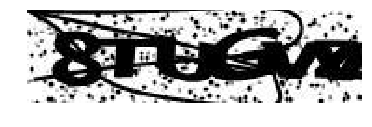

8 T U G V 8 



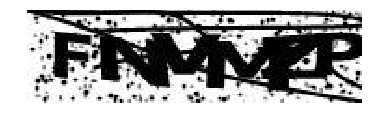

F N V M E P 



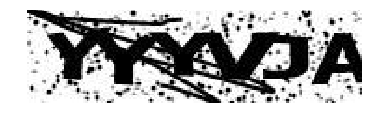

Y Y Y V 2 A 



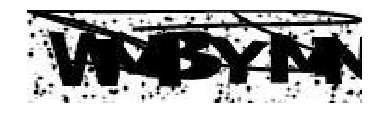

V M B Y N N 



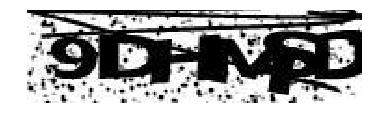

9 D H N 5 D 



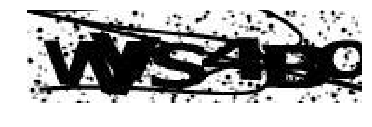

V V 5 4 B O 



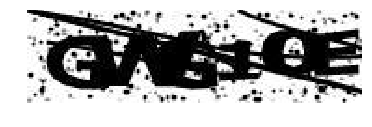

G Y 3 3 O E 



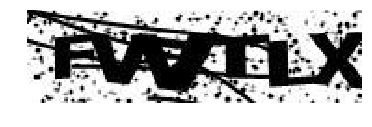

F V B T I X 



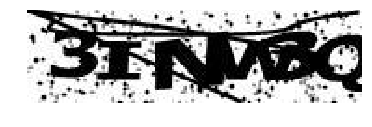

3 I N V Z Q 



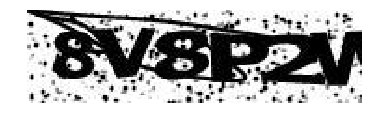

8 V 8 P 2 V 



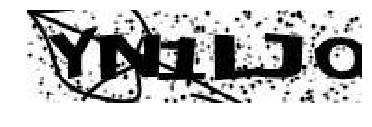

Y N 1 L J O 



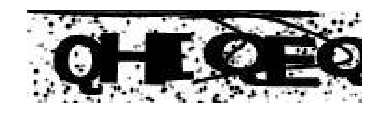

Q H I Q E Q 



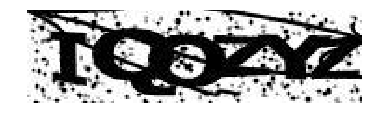

I Q O Z Y Z 



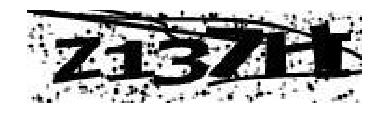

Z 1 3 7 I I 



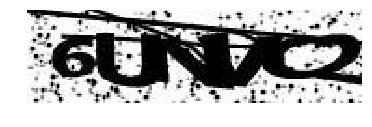

6 U N V O 2 



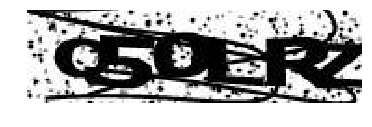

Q 5 0 L R Z 



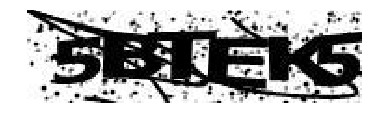

5 B T E K 5 



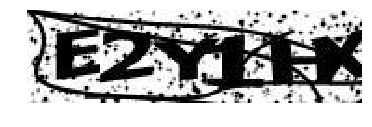

E 2 Y 1 T K 



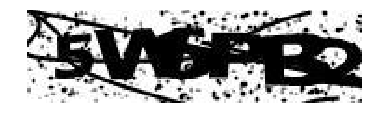

5 V 6 P B 3 



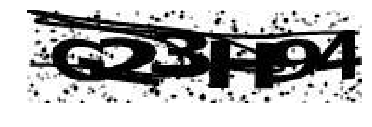

G 2 3 M 9 4 



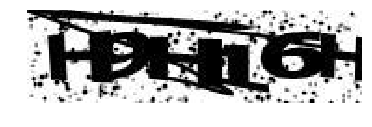

H 9 H V 6 H 



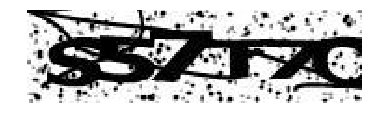

S S 7 T 7 C 



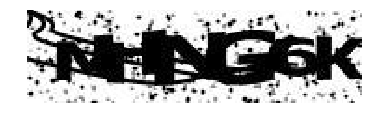

N H N G 6 K 



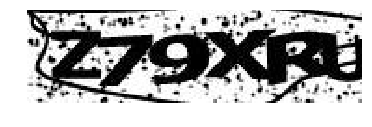

Z 7 9 X R U 



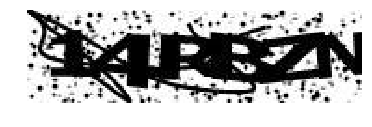

1 4 R B Z N 



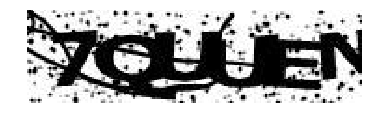

7 Q L U E N 



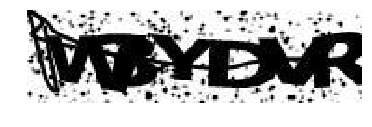

V 3 Y D V R 



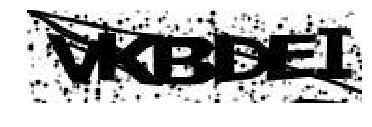

Y K B D E J 



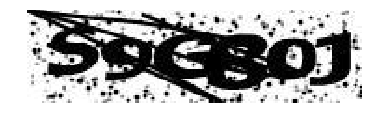

3 9 G B O J 



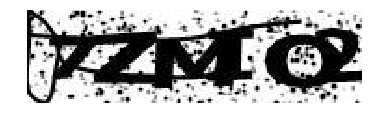

7 Z M I Q Z 



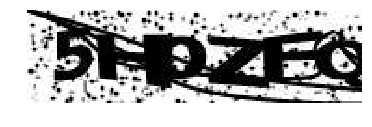

5 H 0 Z E G 



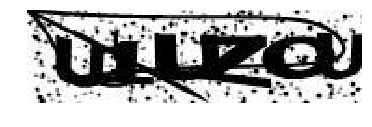

U 1 L Z G U 



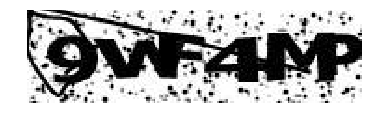

9 V F 4 N P 



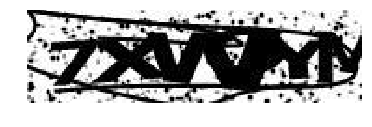

7 X V A Y M 



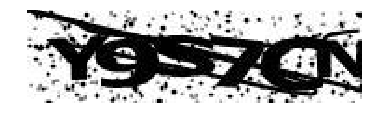

Y 9 S 7 Q N 



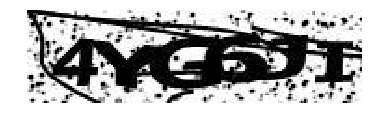

4 Y G 6 J I 



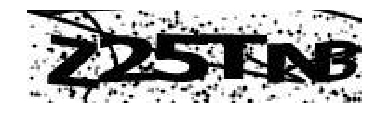

Z 2 S T 4 P 



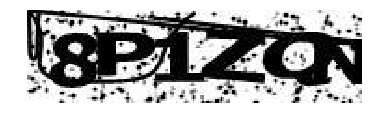

8 P 1 Z Q N 



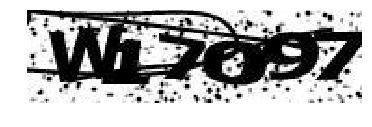

V 1 7 0 9 7 



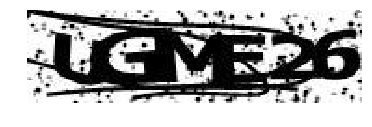

U G N E 2 6 



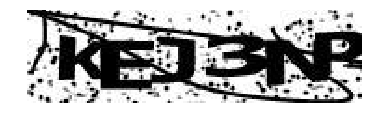

K E J 3 N P 



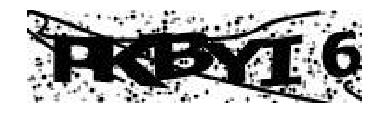

P X B Y I 6 



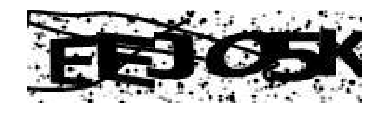

E E J C 5 K 



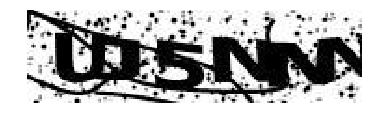

U J S N M N 



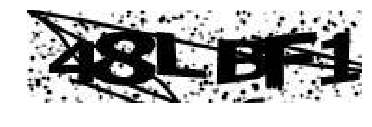

4 S L B F 1 



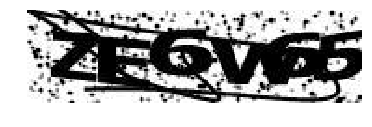

Z E G V 6 6 



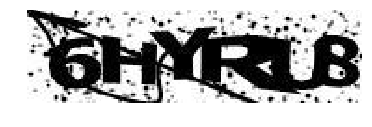

6 H Y R 1 B 



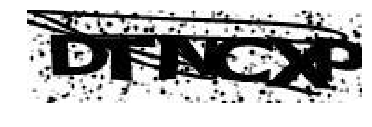

D T N C 1 P 



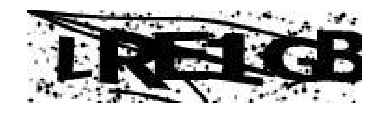

L R E 1 G B 



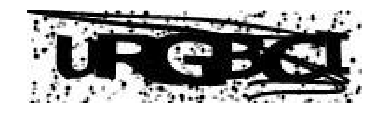

U R G B G I 



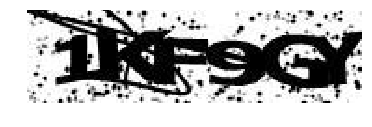

1 K F 9 G Y 



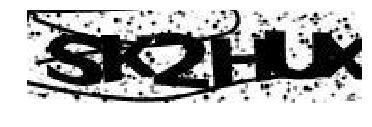

S K 2 H L X 



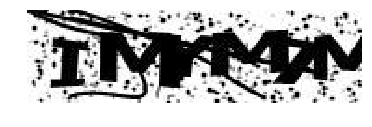

T M Y M P M 



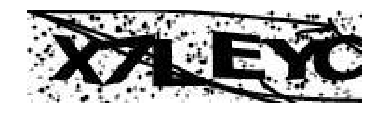

X 7 L E Y C 



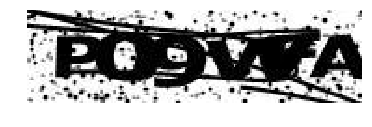

P 0 9 V W A 



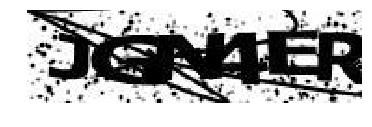

J G N J E R 



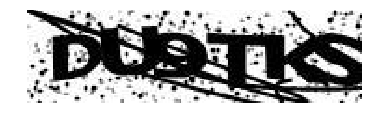

D U 9 T K S 



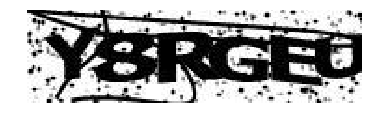

Y 8 R G E U 



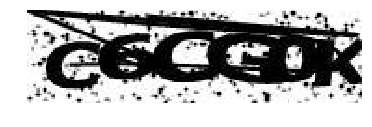

C 6 C G D K 



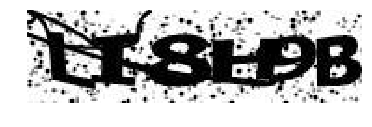

L C 8 L 9 8 



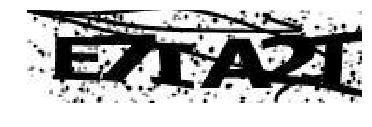

E 7 I A 2 T 



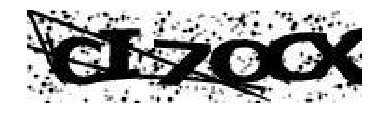

C I 7 Q C X 



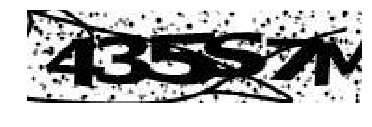

4 3 S S 7 M 



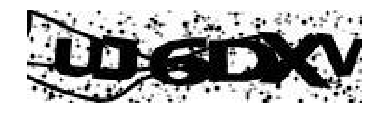

U J 6 D K V 



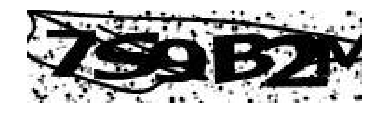

7 5 9 E 2 M 



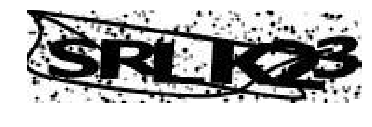

S R L K 3 3 



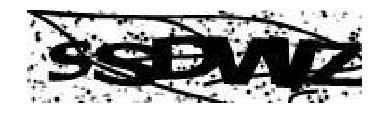

5 S D V Y Z 



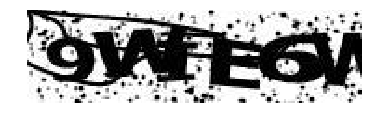

9 Y I E 6 V 



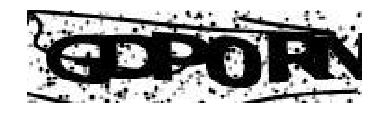

G D P 0 R N 



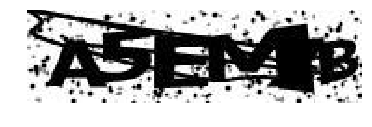

A 5 E M B E 



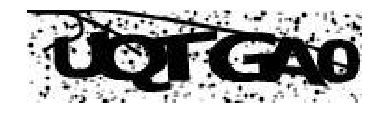

U Q T G A 0 



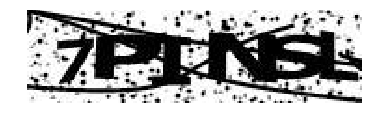

Y P I N 5 L 



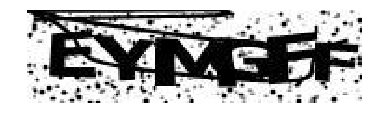

E Y M C F F 



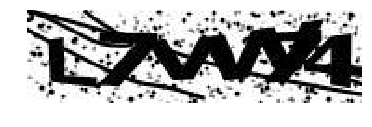

L 7 V V 7 1 



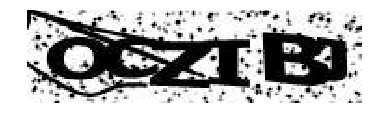

O C Z T B J 



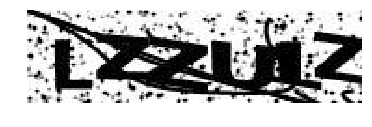

L Z Z U 1 Z 



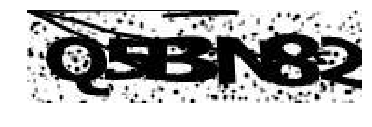

Q S 3 N 6 2 



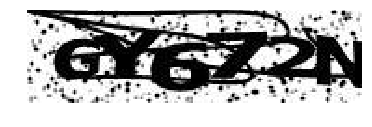

G Y 6 7 2 N 



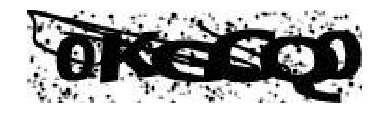

0 K G C Q 9 



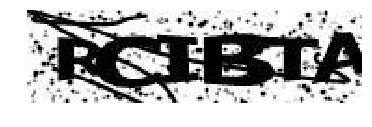

R C J B T A 



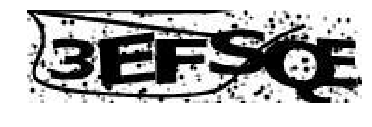

3 E F S Q E 



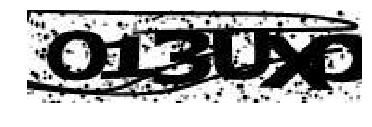

D 1 3 U Y D 



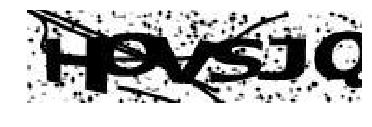

K O V S J Q 



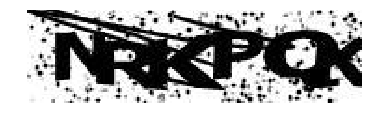

N R K P Q K 



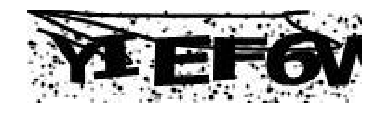

Y I E T 6 V 



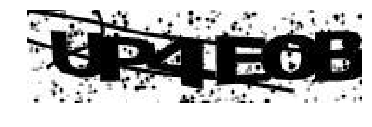

U P 4 E 0 B 



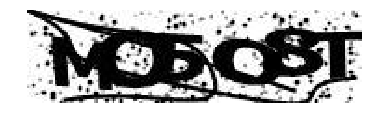

H C 5 C E T 



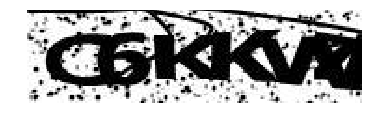

C 6 K K V B 



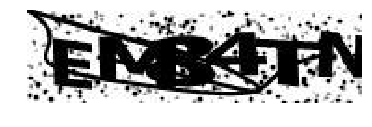

E M 8 4 T N 



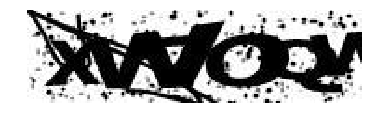

X V P O D V 



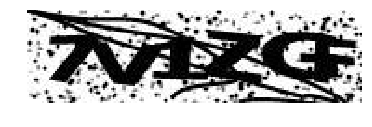

7 V 1 Z G F 



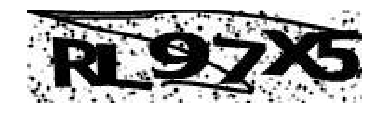

R L 9 7 X 5 



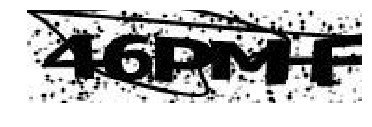

4 6 P N M F 



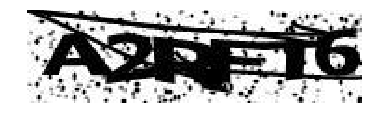

4 2 R F T 6 



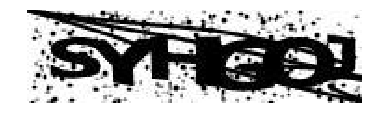

S Y H O C 2 



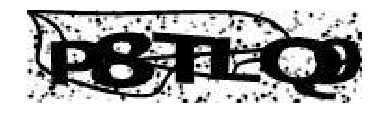

P 8 T L Q 9 



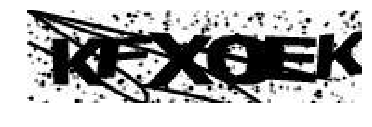

K F X 0 E K 



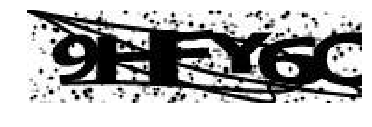

9 H F T 6 C 



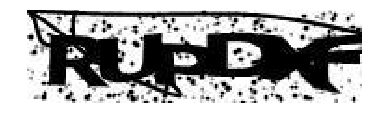

R U O D K F 



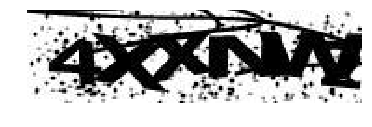

4 X X N V 4 



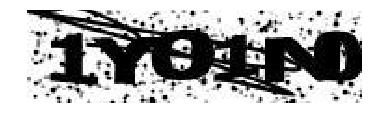

1 Y 0 1 A 0 



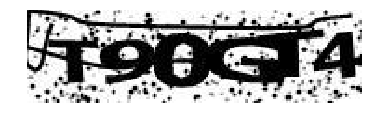

T 9 0 G T 4 



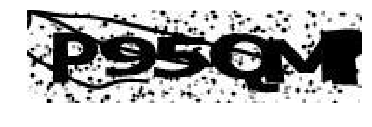

P 9 S Q M 4 



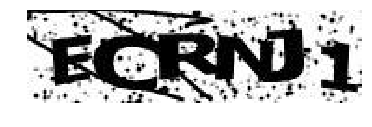

E C H N J T 



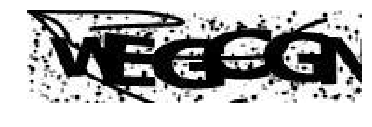

V E G C G N 



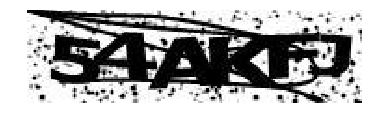

5 4 A K F J 



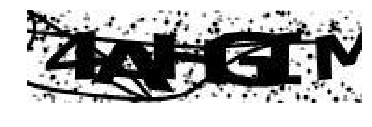

4 A M G I M 



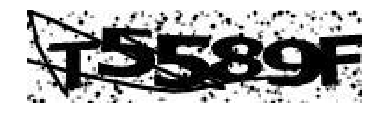

T 5 5 8 9 F 



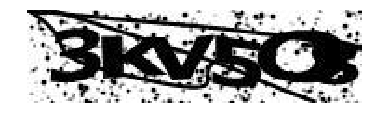

3 K V 5 C X 



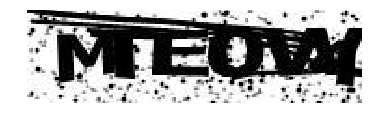

M T E 0 W Y 



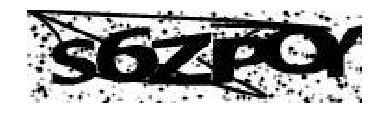

5 6 Z P C Y 



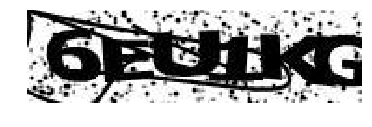

6 E U 1 K G 



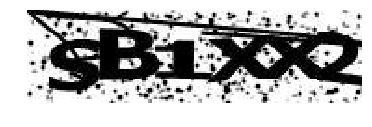

5 B 1 X X 2 



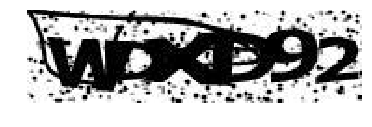

W D X D 9 2 



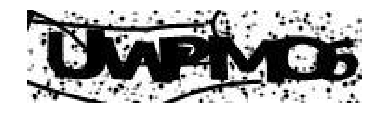

U V P M C 6 



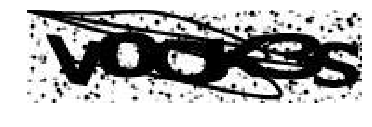

V 0 O K 3 5 



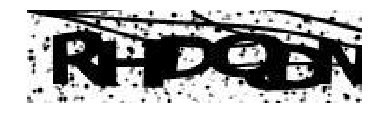

R H D Q 8 N 



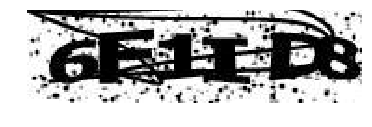

6 F 1 I O 8 



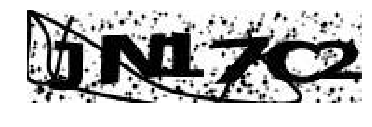

J N 1 7 Q 2 



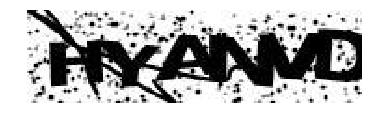

N Y A N V D 



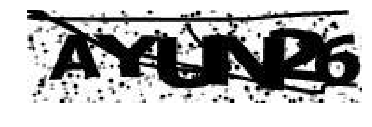

A Y L N B 6 



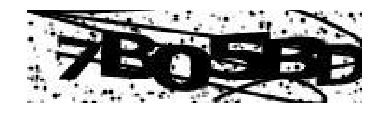

7 B 6 5 B B 



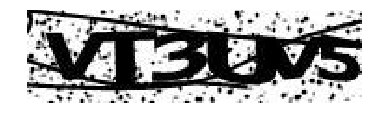

V T 3 U V 5 



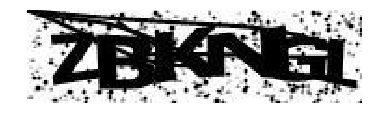

Z B K N G 1 



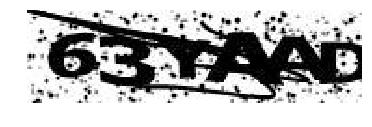

6 3 T A A D 



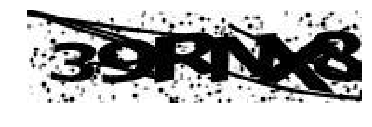

3 9 R N M 8 



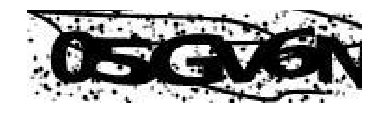

0 S G V 6 N 



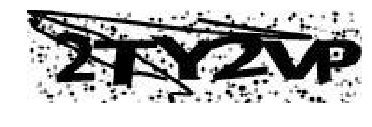

2 T Y 2 V P 



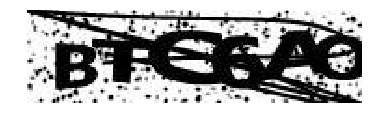

5 T G 6 4 O 



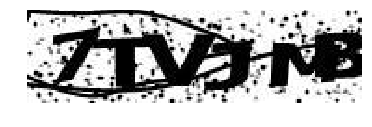

7 T V 1 Y B 



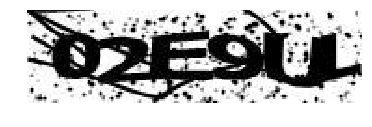

0 2 E 9 U L 



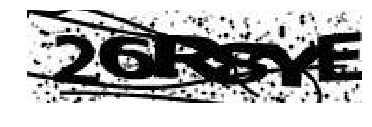

2 6 R 5 Y E 



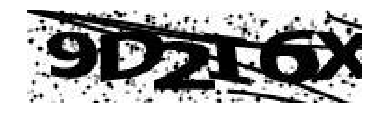

9 D 3 I 6 X 



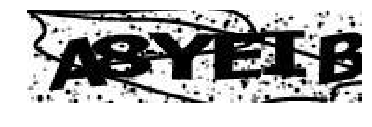

A 8 Y E 1 B 



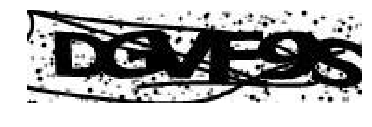

D G V F 9 S 



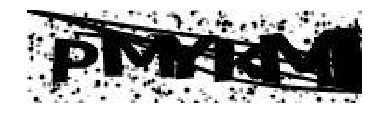

P M Y K N A 



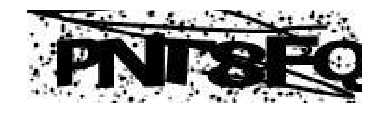

P N T 5 F Q 



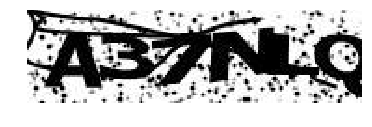

A 3 7 N L Q 



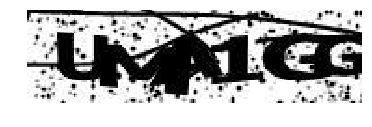

U H A 1 G G 



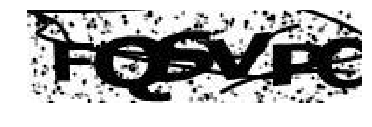

F Q 5 V V C 



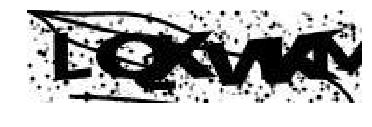

L Q X V W M 



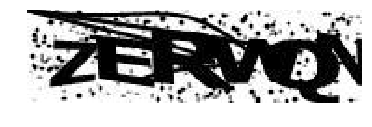

Z E R V T N 



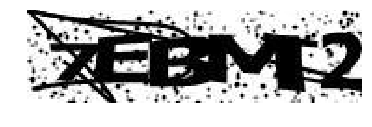

7 E 3 M T 2 



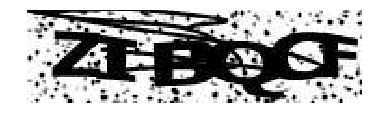

Z I 3 Q C F 



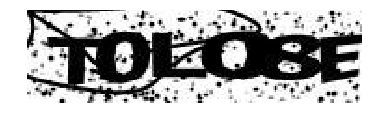

T 0 L 0 8 E 



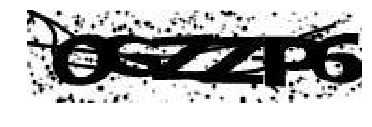

O G Z Z P 6 



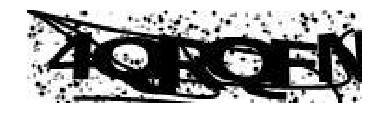

4 Q R Q F N 



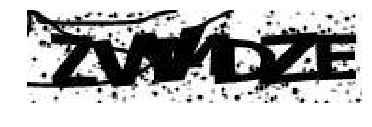

Z V J D Z E 



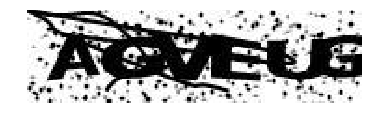

A G V E U G 



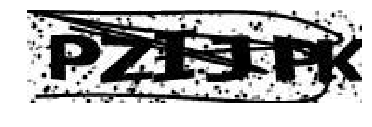

P Z I J T K 



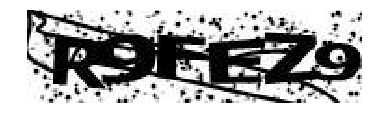

R 9 F E Z 9 



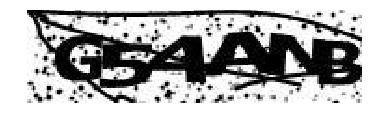

G 5 4 A N B 



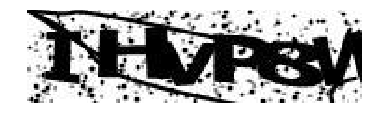

I N V P 8 V 



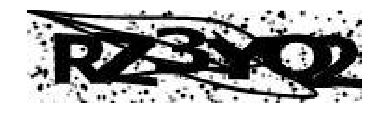

R Z 3 Y Q 2 



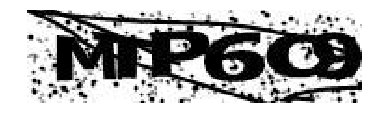

M T P 6 G B 



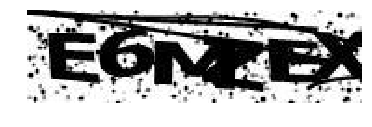

E 6 M Z O X 



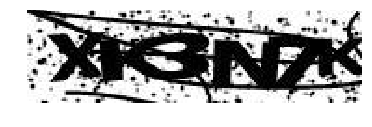

X K 3 N 6 K 



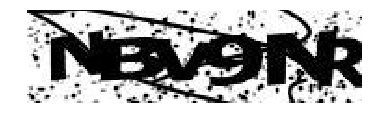

N B V 9 N R 



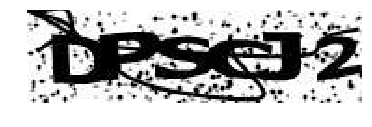

D P S G J 2 



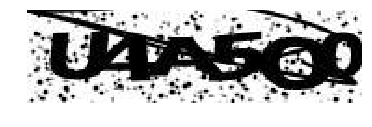

U 4 A 5 O 0 



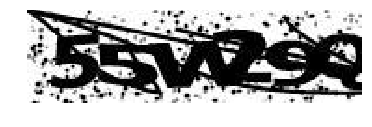

S 5 V 2 3 Q 



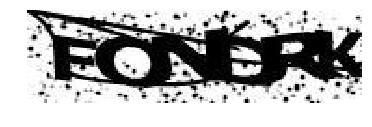

F O N D P K 



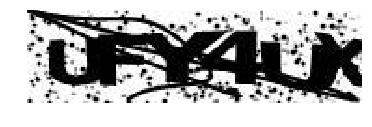

U F Y 4 U K 



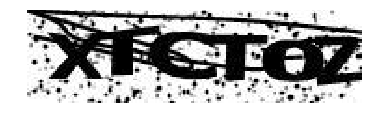

X T C T O Z 



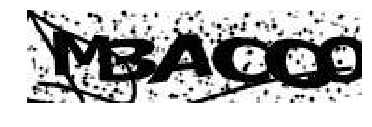

M 3 A O O O 



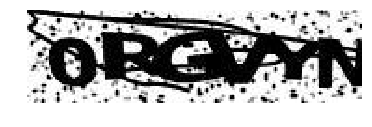

0 R G V Y N 



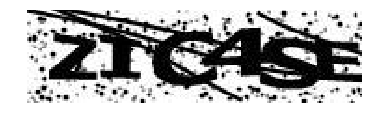

Z I C 4 5 E 



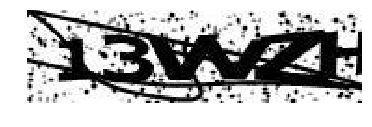

1 3 V V Z K 



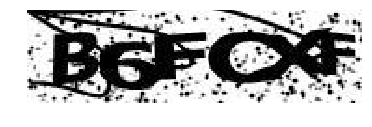

8 6 F C X F 



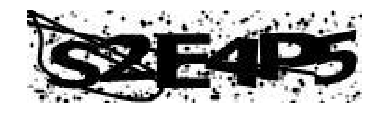

S 2 E 4 P 5 



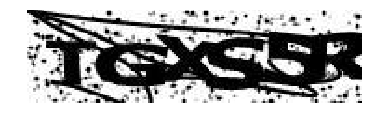

T G X 5 S R 



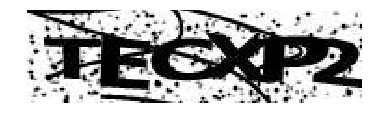

T E C X P 2 



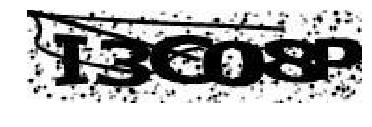

I 3 C 0 8 P 



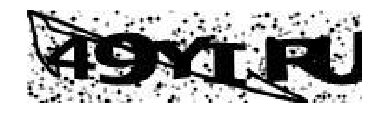

4 9 Y I F U 



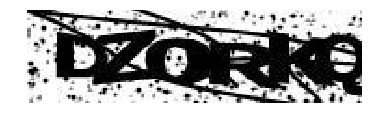

O Z 0 R M Q 



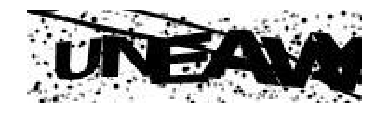

U N E A V X 



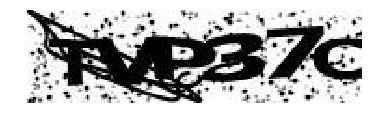

T V P 3 7 C 



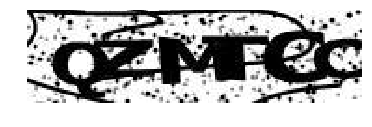

Q Z M T C O 



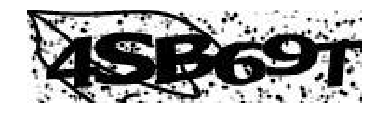

1 S B 6 5 T 



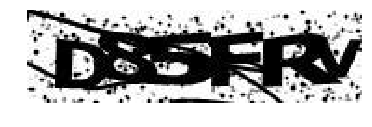

0 8 5 F R V 



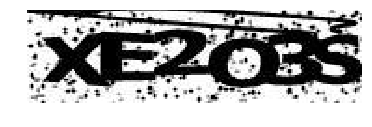

X E 2 O 6 S 



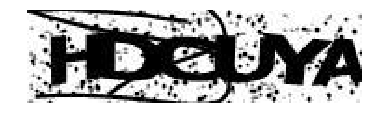

K D C L N A 



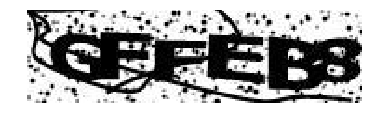

G F F E B 8 



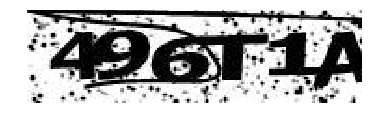

4 9 6 T 1 A 



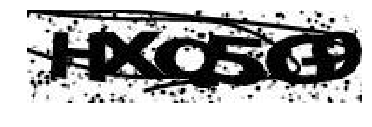

H X Q S G 9 



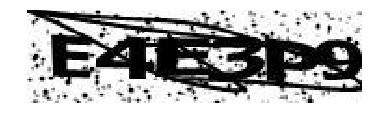

E 4 6 3 P 9 



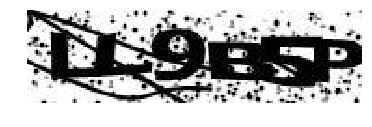

L L 9 B 5 P 



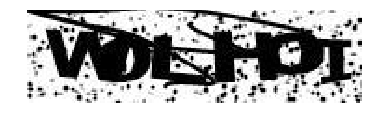

V 0 L H 0 1 



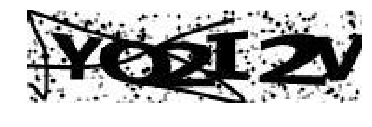

Y C D I 2 V 



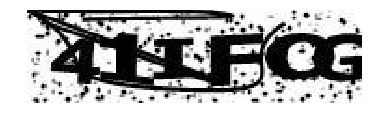

4 1 I F O G 



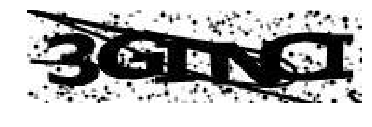

3 G I N C J 



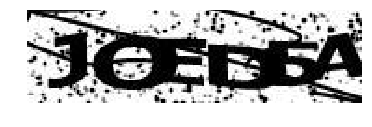

J C E E 6 A 



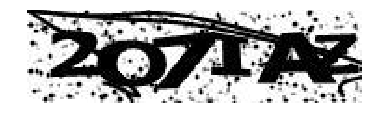

2 C 7 J A Z 



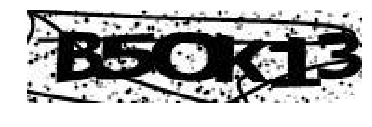

B 5 C K 1 3 



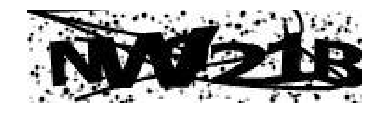

N V B 3 1 B 



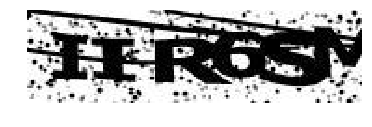

I I R 6 S M 



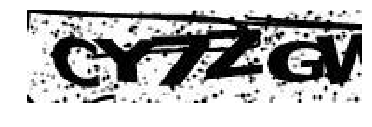

O Y 7 Z O V 



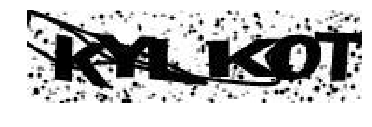

K Y L K O T 



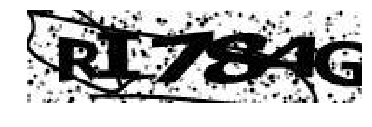

R I 7 8 4 G 



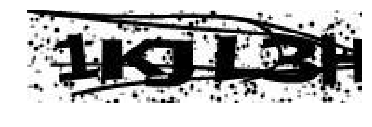

1 K J L 3 K 



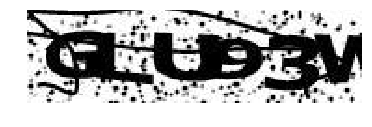

G L U 9 3 V 



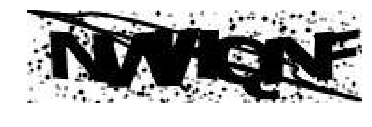

N V K Q 0 F 



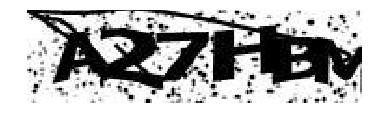

A Z 7 H E H 



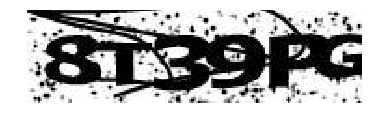

8 T 3 9 F G 



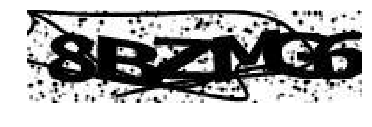

8 B Z M G 6 



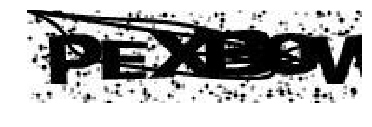

P C X B 0 V 



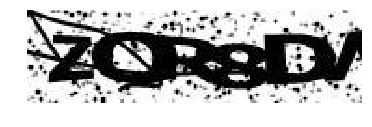

3 C R 8 D V 



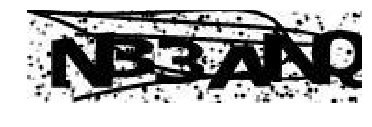

N 8 3 X N D 



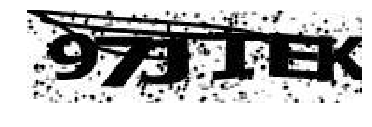

9 7 J 1 E K 



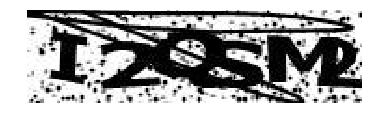

I 2 Q 5 N 3 



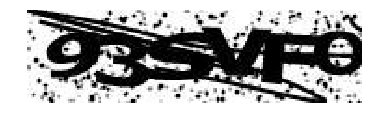

9 3 S V F 0 



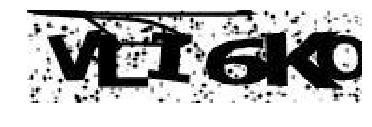

V L I 6 K D 



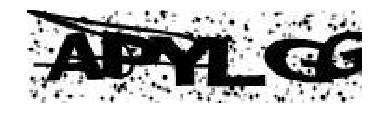

A P Y L G G 



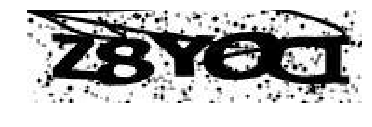

Z 8 Y C C I 



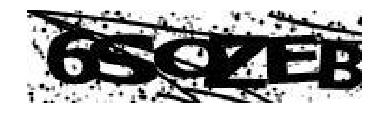

6 S C Z E 8 



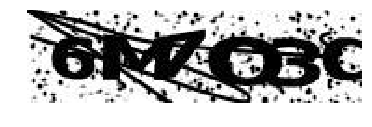

6 M 7 Q B Q 



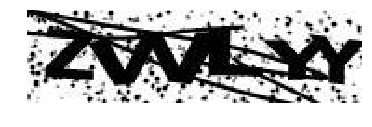

Z V V L Y Y 



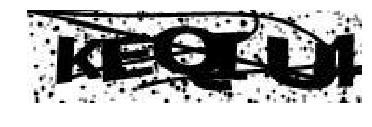

K E B I U 4 



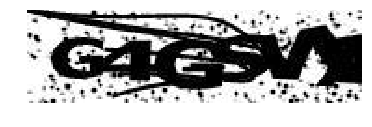

G 4 G 5 V X 



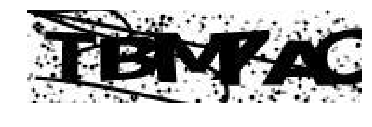

T B M T 1 C 



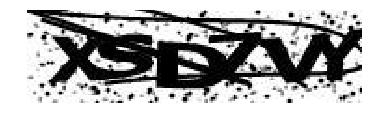

X S E 7 V Y 



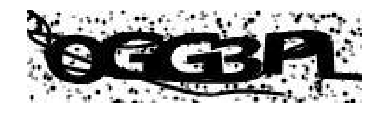

O G G 3 F L 



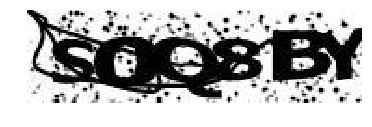

S 0 Q 8 G Y 



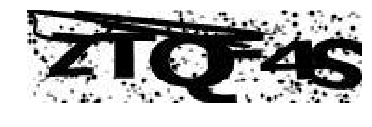

Z T Q F 4 8 



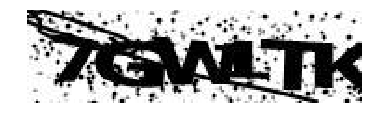

7 G V 1 T K 



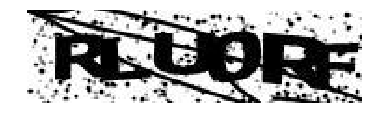

R L U 0 R F 



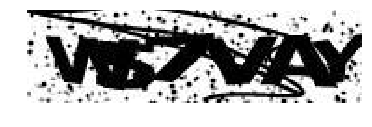

V 8 7 V 3 Y 



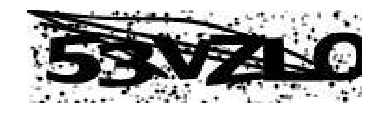

5 3 V 2 L O 



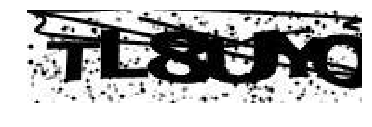

T L 8 U N Q 



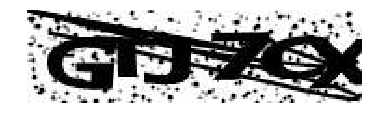

G T J 7 G X 



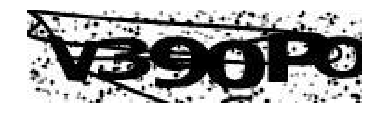

V 3 9 0 F O 



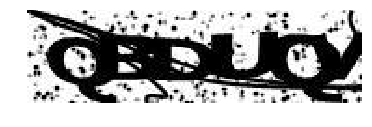

Q B D U O V 



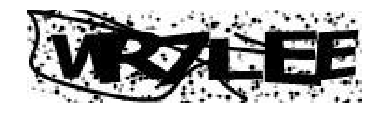

V R 7 L E E 



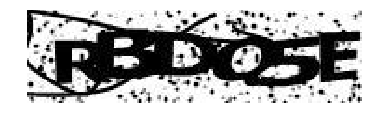

R 8 D O 5 E 



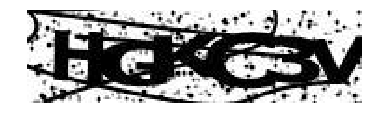

H G K C 3 V 



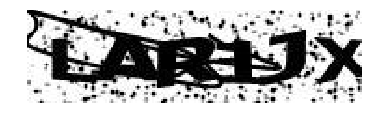

L A R 1 J X 



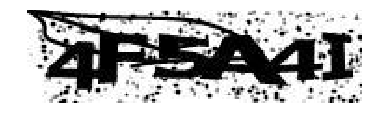

4 F 5 A M 1 



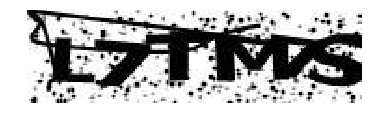

L 7 T N 7 S 



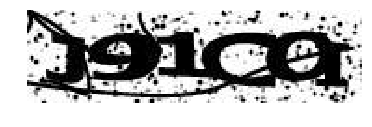

J 9 1 C C I 



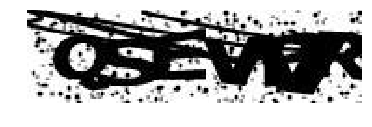

Q 5 E V Q R 



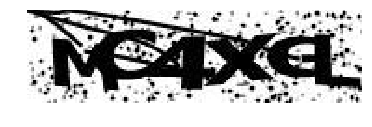

M C 4 X G L 



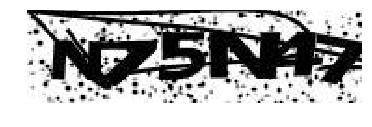

N 7 5 N K 7 



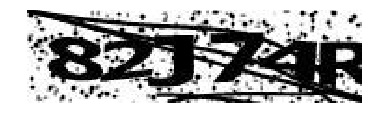

8 2 J 7 4 R 



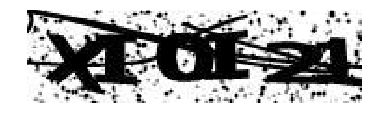

X I O I 3 1 



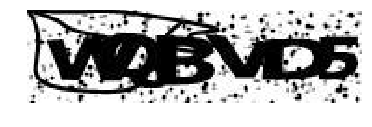

V O B V D 6 



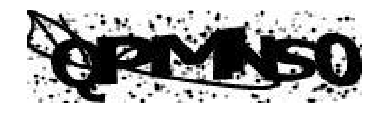

6 P M A S 0 



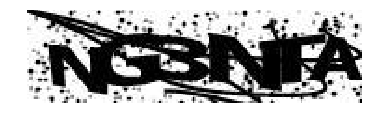

4 G 3 N Y A 



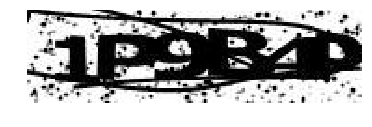

1 P 9 B 4 P 



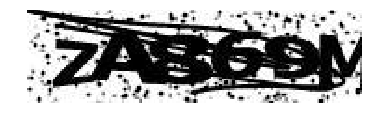

2 A 8 6 9 M 



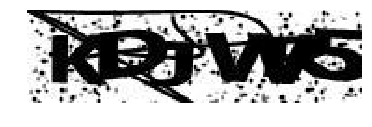

K D J V W S 



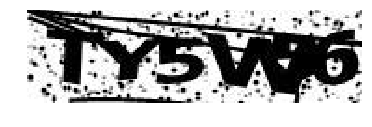

T Y S V 8 6 



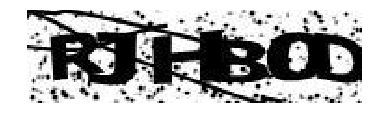

R J H B Q D 



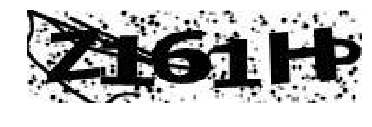

Z 1 6 1 H P 



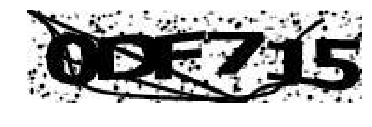

0 O F 7 1 5 



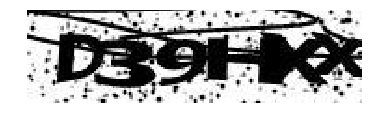

0 3 9 H K X 



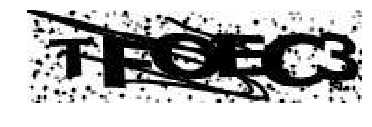

T F O E C 3 



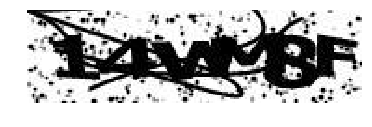

1 4 V M B F 



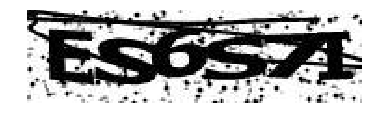

E S 6 S 7 I 



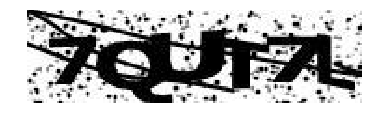

7 Q U T 7 L 



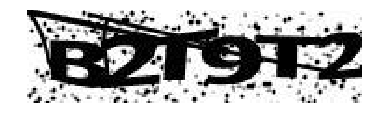

B 2 T 9 T 2 



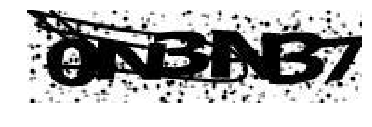

0 N 5 N B T 



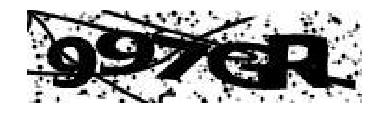

9 9 7 G R L 



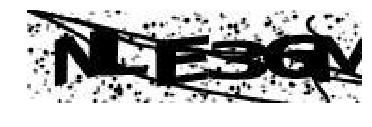

N L E 5 6 M 



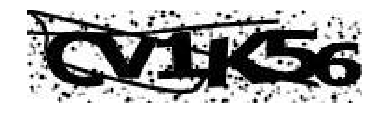

C V 1 K S 6 



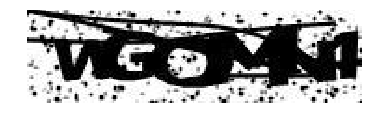

W G C M A 4 



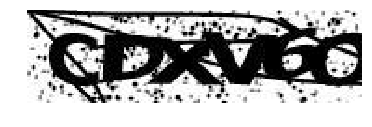

C D X V G O 



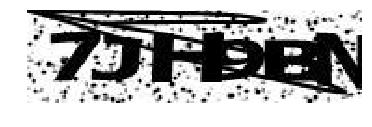

7 J H B B N 



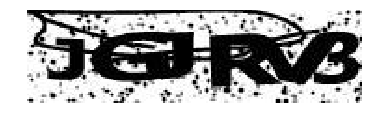

J G J R V 5 



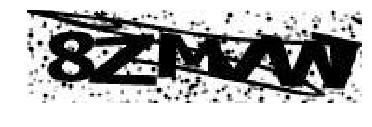

8 Z M V V Y 



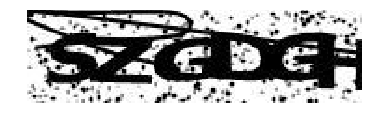

S Z G D G H 



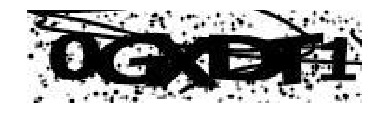

0 G X D T 1 



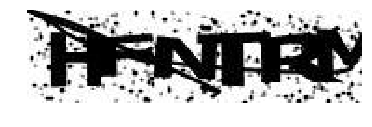

H F N T R M 



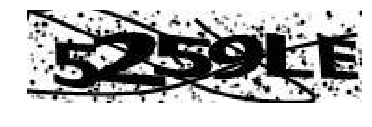

S Z S 9 L E 



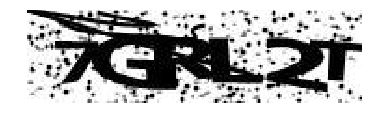

7 G R L 2 T 



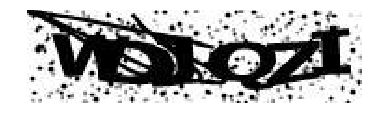

V D J Q 2 I 



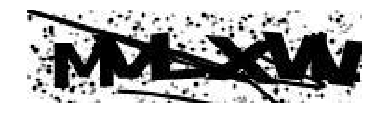

M P L X V V 



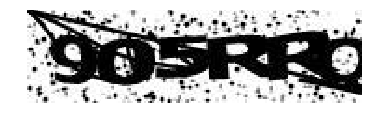

9 0 S R F Q 



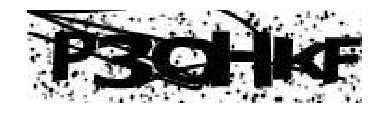

P 3 C H 1 F 



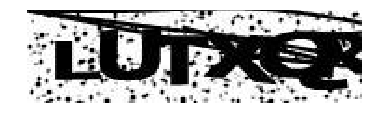

L U T X G R 



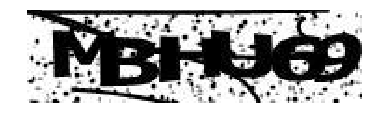

M B H U 6 9 



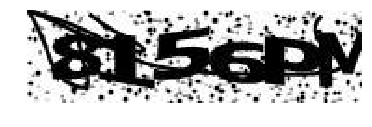

8 1 5 6 P M 



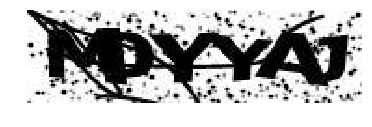

M 9 Y Y A J 



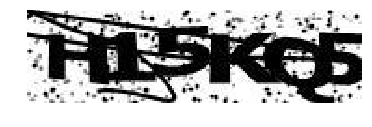

H 1 E K Q 6 



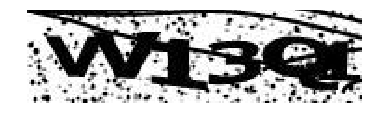

V V 1 3 Q 1 



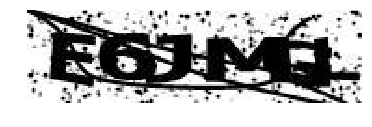

E 6 J M O L 



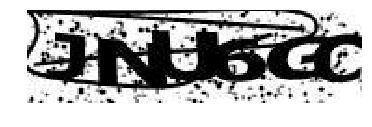

J N U 6 C C 



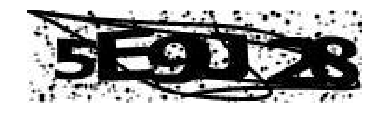

S E 9 1 2 8 



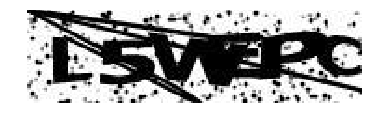

L 5 V X F D 



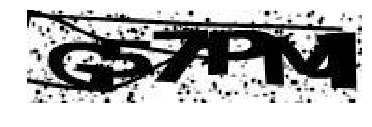

G S 7 F N 4 



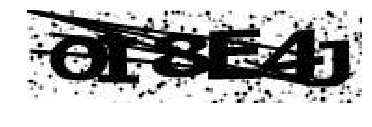

O I 8 E 4 J 



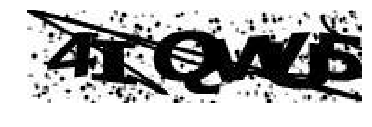

4 C Q V I 6 



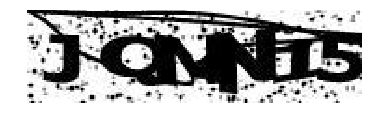

J Q N K U 5 



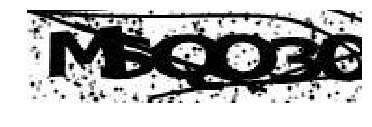

M 5 Q O O O 



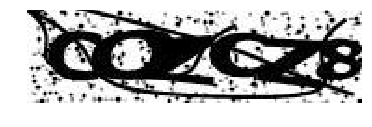

O C Z G Z 8 



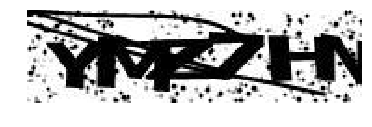

Y H P 7 H N 



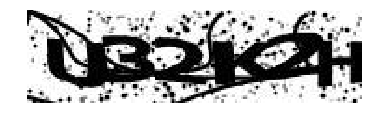

U 3 2 K 2 K 



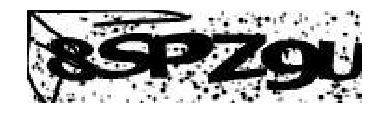

8 S P Z 9 U 



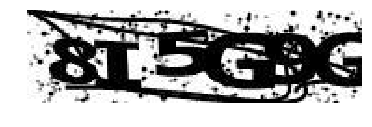

8 I 5 G B G 



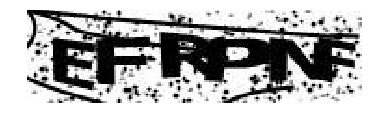

E F N P N F 



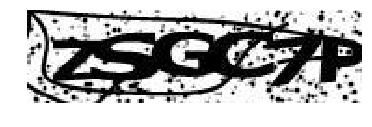

Z S G O 7 P 



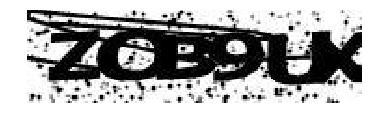

Z C B 9 L K 



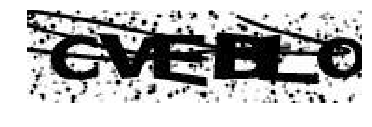

C V E B L O 



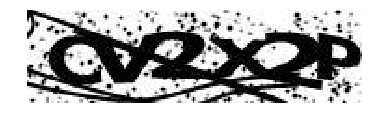

C V 2 X 2 P 



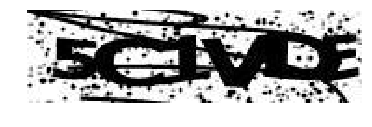

5 C 1 V D E 



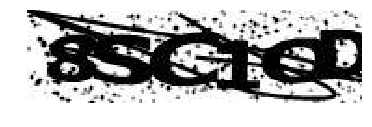

8 S C 1 C D 



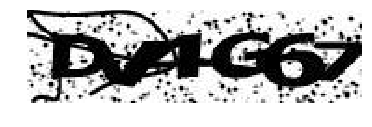

D V 4 G 6 7 



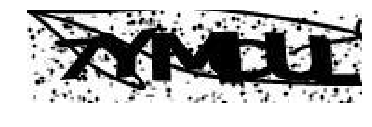

7 Y M 1 L L 



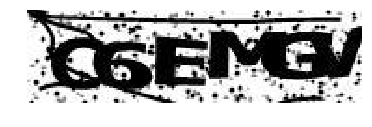

O 5 E M G V 



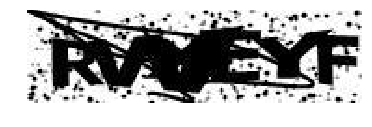

R V W E Y F 



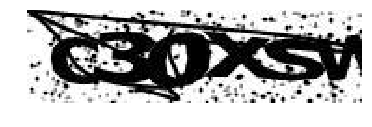

C 3 0 X S V 



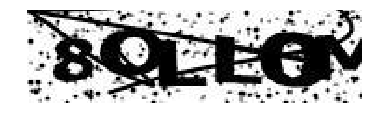

8 O L L G M 



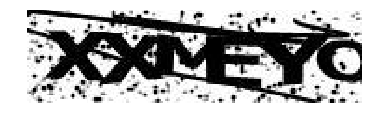

X X M E Y O 



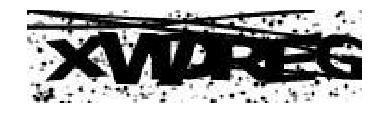

X V Z R E G 



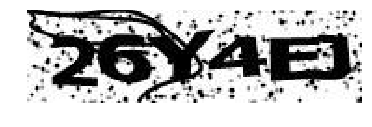

2 6 Y 4 E J 



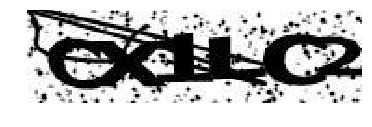

C X 1 L C 2 



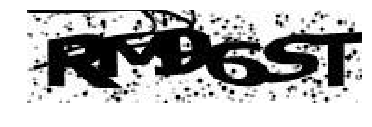

R M 9 6 S T 



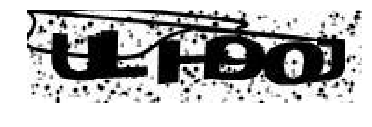

U L H 9 U J 



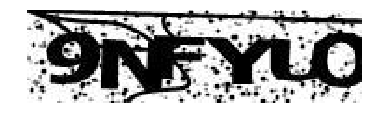

9 N F Y 1 O 



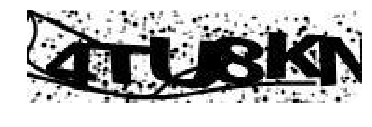

1 T U B K N 



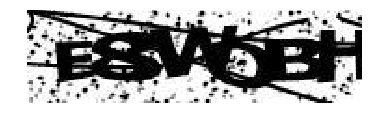

G 8 V O D H 



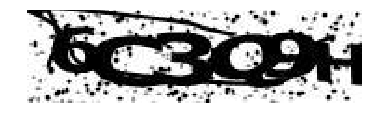

9 C 3 Q 9 H 



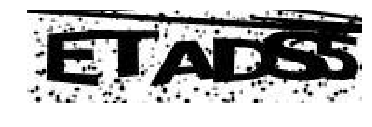

E T A O 5 5 



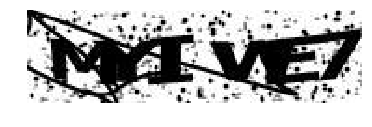

M Y I V E 7 



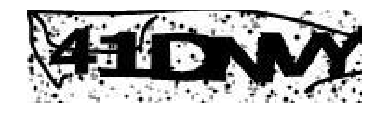

4 1 D N M Y 



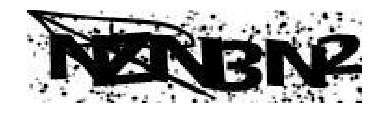

N 2 N R N D 



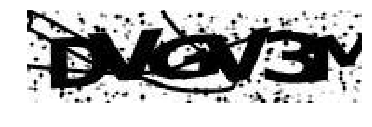

D V G V 2 M 



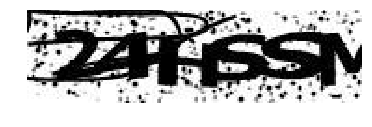

2 4 F 5 S N 



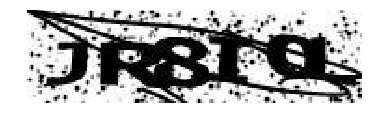

J R 8 I O L 



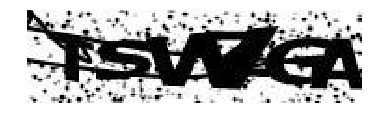

T S V 9 G A 



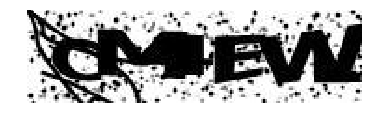

O M A E V V 



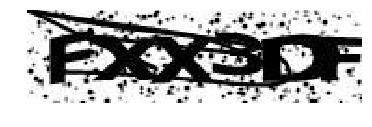

F X X 3 C F 



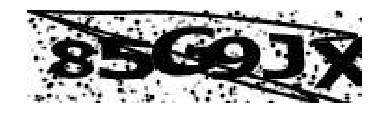

8 5 E 9 J X 



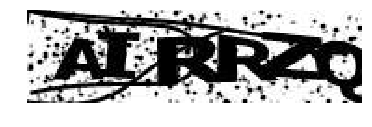

A I R M Z Q 



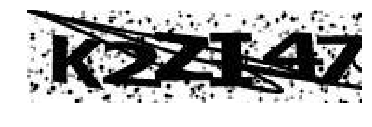

K 2 Z 1 4 7 



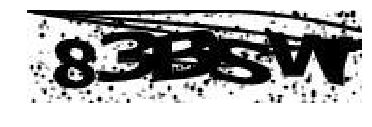

5 3 B S M T 



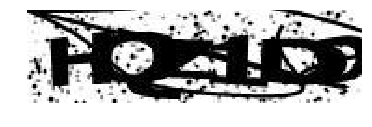

H Q Z 1 O E 



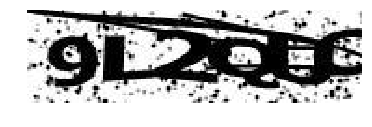

9 L 2 Q O O 



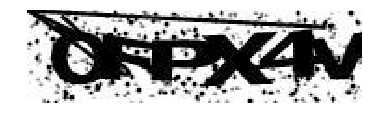

O R P X 4 V 



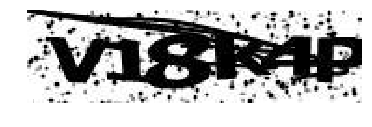

V 1 S K 4 P 



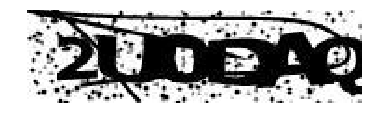

2 U 0 C A Q 



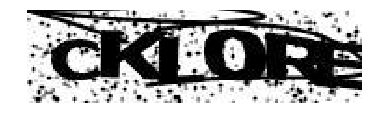

C K L D R E 



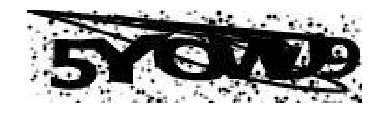

S Y O 9 X 9 



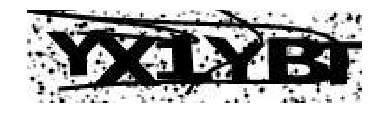

Y X 1 Y B T 



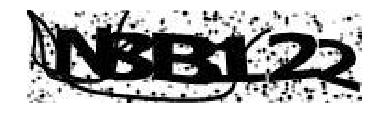

N 8 B 1 2 2 



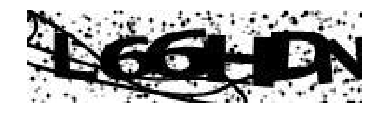

L 6 6 H D N 



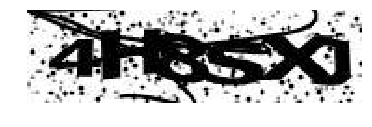

4 H 8 S X J 



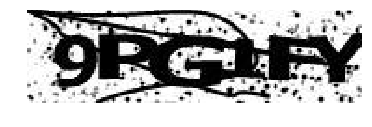

9 P C 1 F Y 



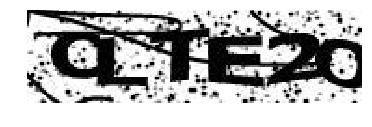

O L T E 2 O 



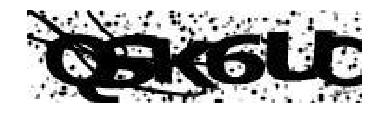

Q 5 K 6 L D 



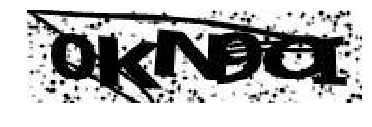

0 K N B O I 



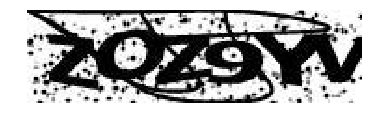

Z O Z 9 Y V 



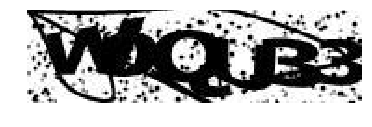

V A Q U D 3 



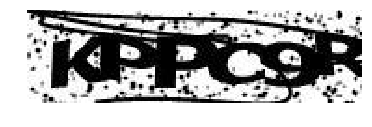

K P P C 6 R 



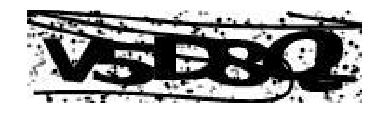

V S D 8 Q L 



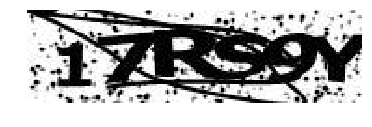

1 7 R S 9 Y 



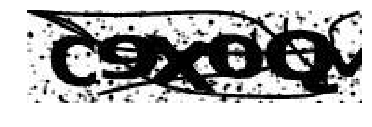

C 9 X 0 G M 



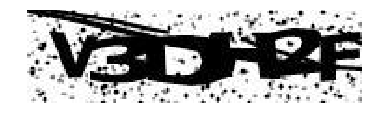

V 3 D H P F 



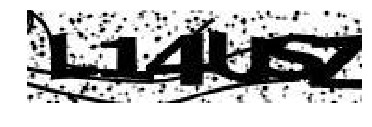

L 1 4 U S Z 



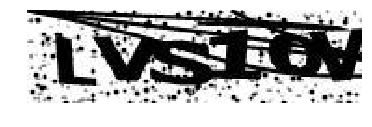

L V S 1 A Y 



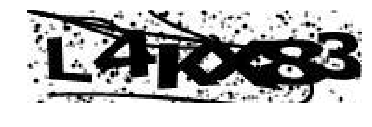

L 4 N X 8 2 



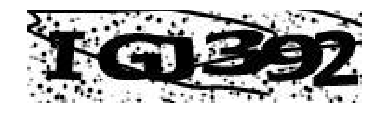

I G J 3 9 2 



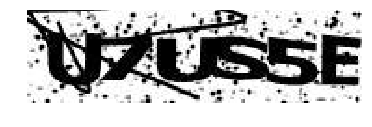

U 7 U S 5 E 



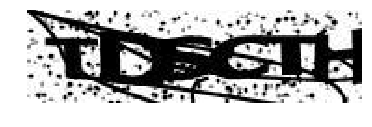

T D 5 O T H 



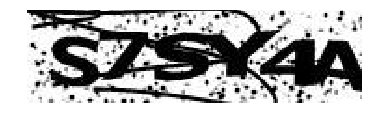

S 7 S Y 4 A 



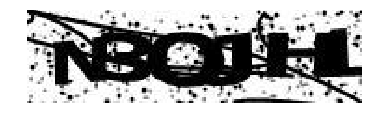

N 3 O J H 1 



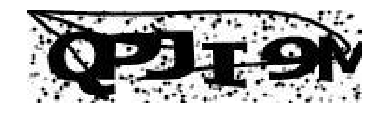

Q P J I 9 M 



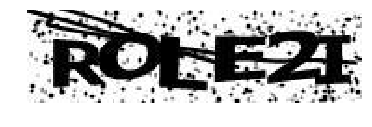

R O L E 2 I 



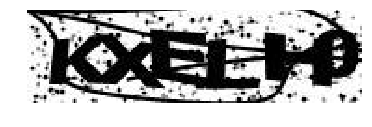

K X E L H 9 



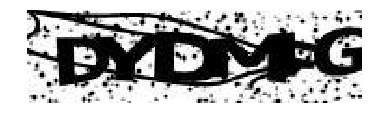

D Y D N 4 G 



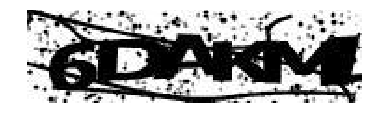

5 O A K N 1 



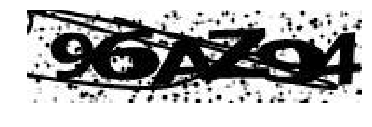

9 6 A Z 3 4 



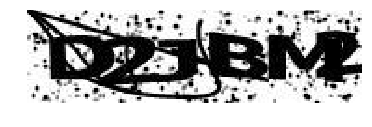

D 2 J B N Z 



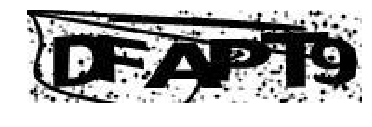

D F A P T 9 



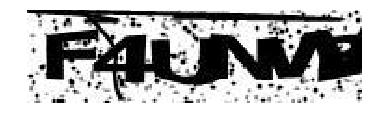

F 4 U N V X 



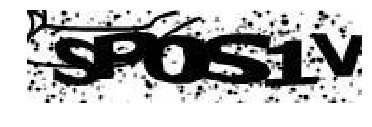

8 P 0 S 1 V 



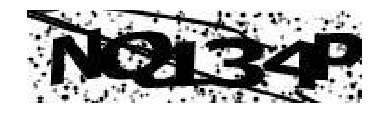

N Q 1 3 4 P 



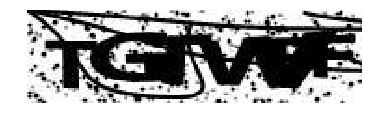

T G T V B F 



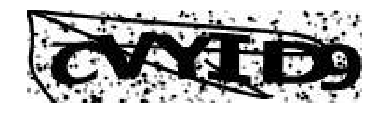

C V Y I D 9 



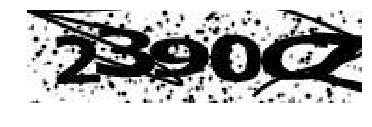

2 3 9 0 C Z 



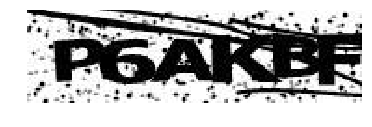

P 6 A K 3 P 



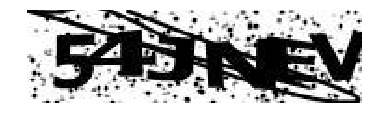

5 7 J N E V 



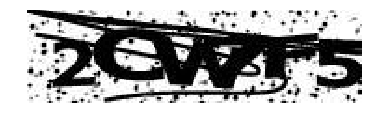

2 C V 7 T S 



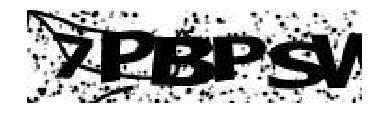

7 P B P 5 V 



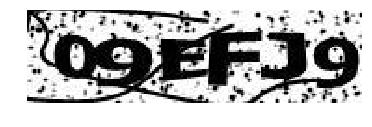

0 9 E F J 9 



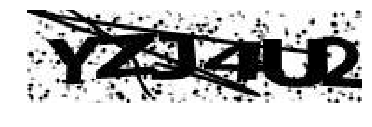

Y Z J 4 U D 



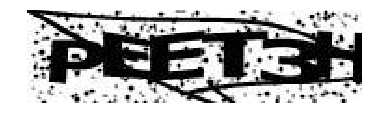

P E E T 3 H 



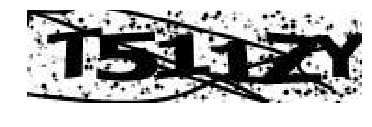

T S 1 1 2 Y 



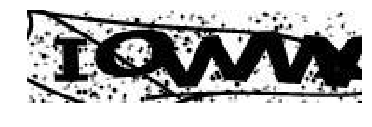

I C V V V K 



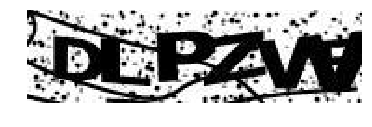

0 L P Z V P 



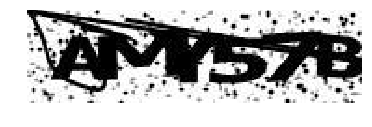

A M Y S 7 8 



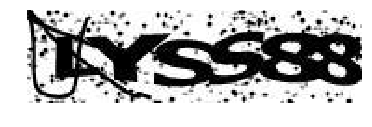

I Y S S 8 8 



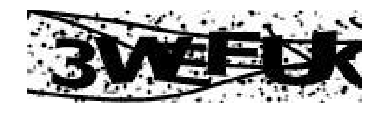

3 V 6 F U X 



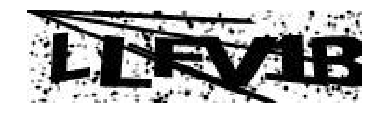

L L E V 1 B 



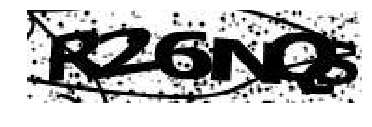

R 3 6 N Q 8 



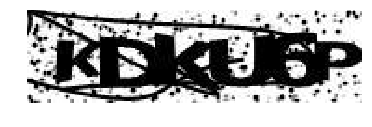

K D K U 6 P 



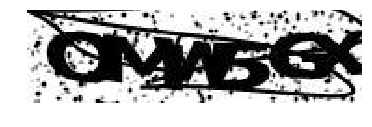

C N V 8 6 X 



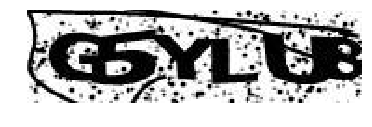

G 5 Y L U B 



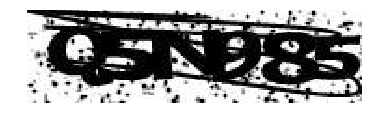

Q 5 N B 8 S 



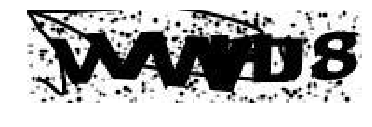

V V V Y 1 8 



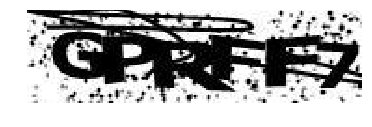

G P R F F 7 



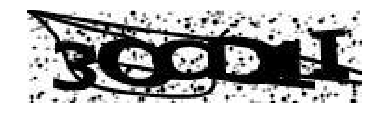

3 C O D 1 I 



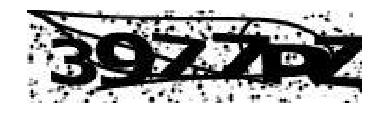

3 9 7 7 D Z 



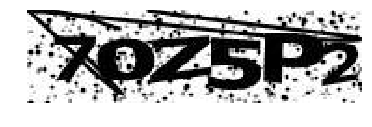

7 0 Z S P 3 



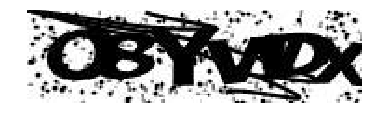

O B Y V Q X 



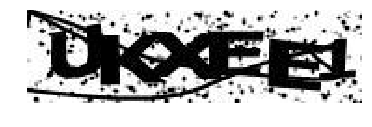

U K X E B 1 



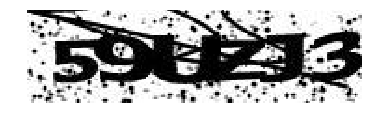

5 9 U 2 J 3 



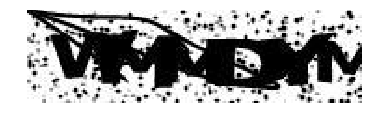

V M M O K M 



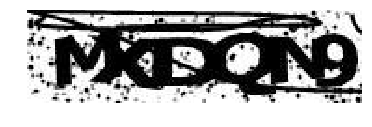

M X D Q N 9 



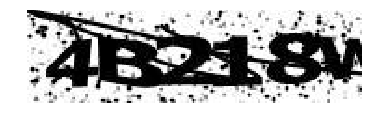

4 B 2 1 8 V 



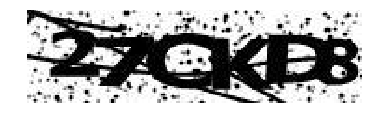

2 7 C K D 8 



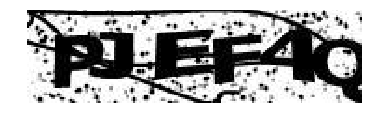

P J E F 4 Q 



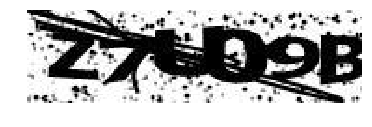

Z 7 U D 9 B 



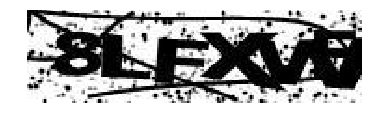

8 L F X V 8 



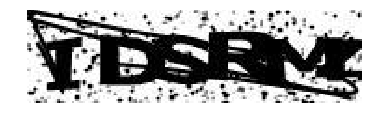

I D S R M 7 



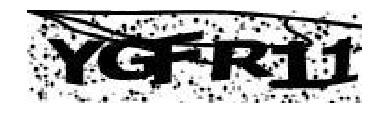

Y G F R 1 1 



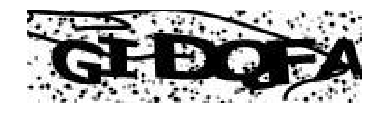

G I D Q F A 



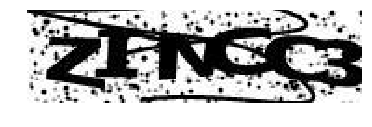

Z I N C Q 3 



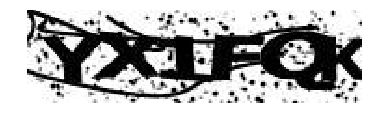

Y X 1 F Q K 



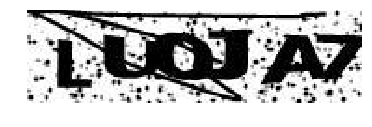

L U 0 J 4 7 



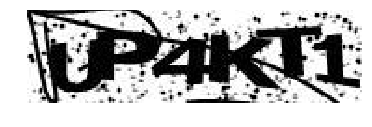

U P 4 K T 1 



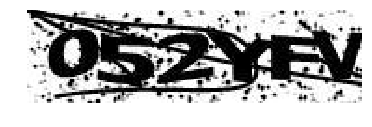

0 S 2 Y F V 



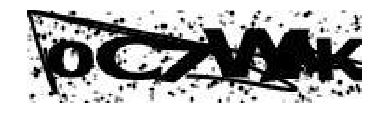

0 C 7 V V K 



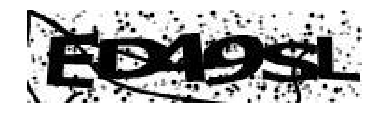

E D 4 9 S L 



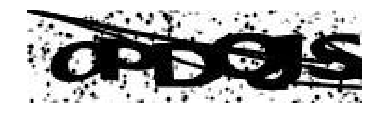

O P D G 1 S 



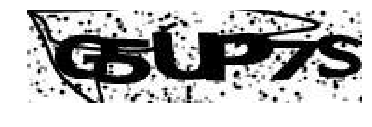

G 5 U P 7 5 



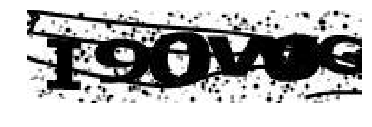

I 9 0 V 9 G 



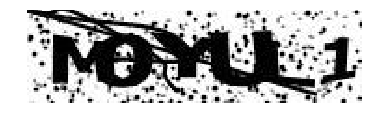

M 0 Y U L 1 



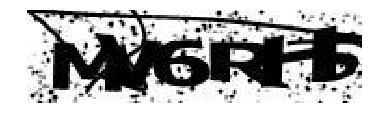

N V 6 R H F 



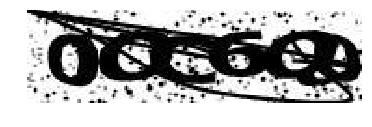

0 O C G G 9 



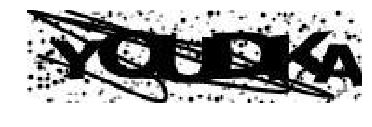

Y O U D H K 



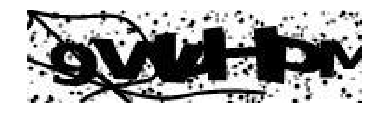

4 V V H P M 



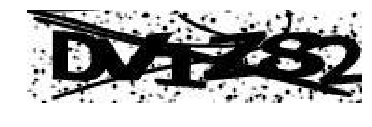

D V Y Z 8 2 



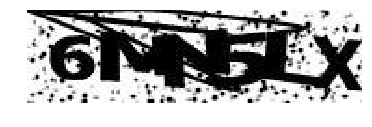

6 N M 5 L Y 



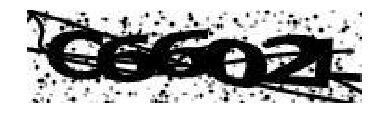

C 6 6 0 2 L 



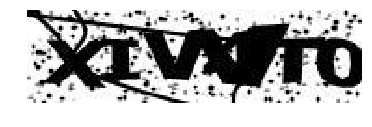

X I V B T 0 



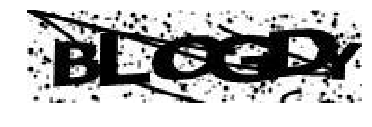

B L O G I Y 



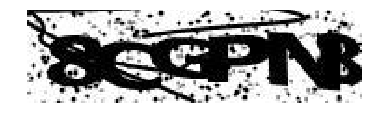

8 C G P N 8 



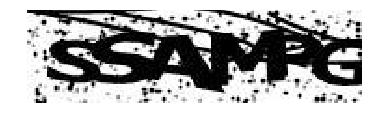

S S A M P G 



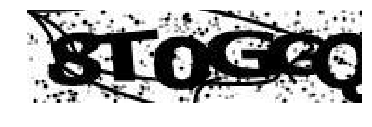

8 T 0 G G Q 



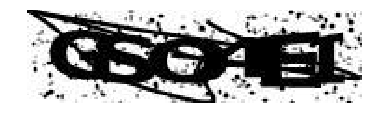

G S G 4 E I 



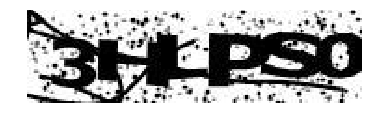

3 H L P S 0 



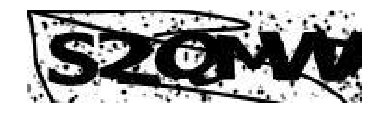

S Z Q M V W 



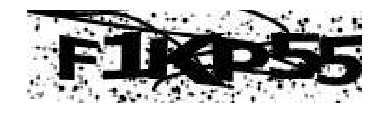

F 1 K P 5 5 



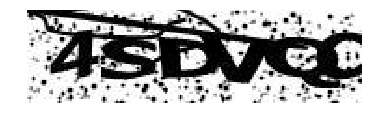

4 S D V O O 



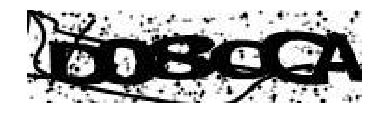

D 0 8 Q C A 



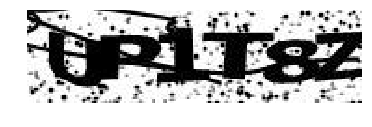

U P J T 8 Z 



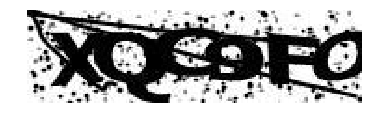

K Q C 9 F O 



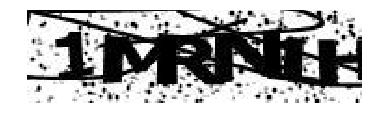

1 M R N A M 



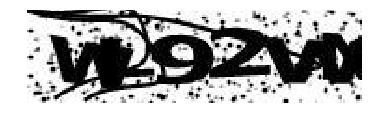

V L 9 2 V V 



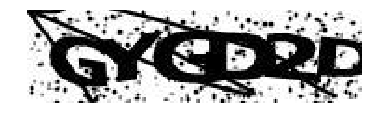

G Y G D 2 D 



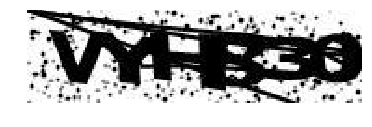

V Y H B 3 0 



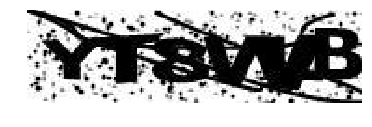

Y T 8 V W 8 



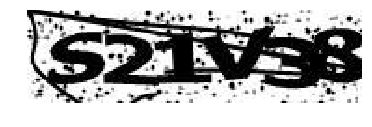

S 2 1 V 3 B 



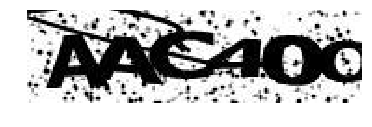

A A C 4 0 O 



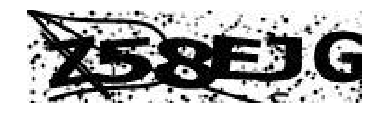

Z S 8 E J G 



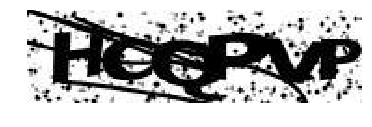

H O Q P V P 



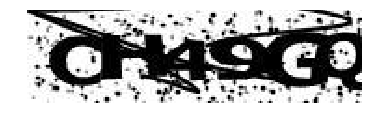

C H 4 5 G O 



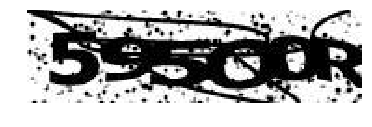

5 9 S D D R 



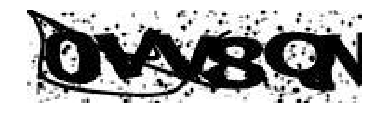

D V V 8 O N 



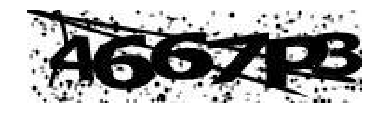

4 6 6 7 P E 



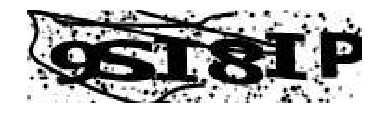

9 S I B 1 P 



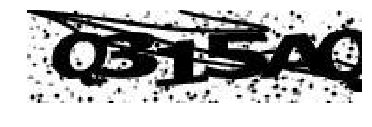

Q 3 1 5 A Q 



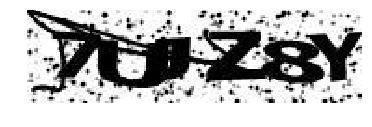

7 U J Z 8 Y 



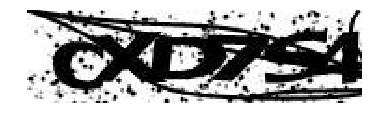

O X D P S 4 



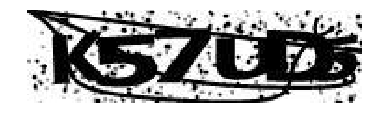

K S 7 U D A 



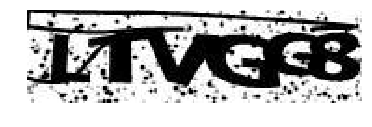

L T V G G 8 



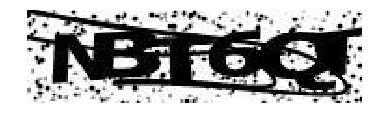

N 8 T 6 Q T 



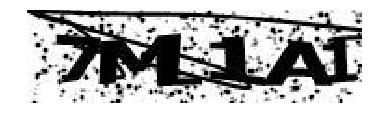

7 M L 1 7 1 



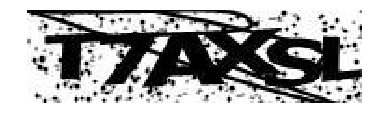

T 7 A X 5 L 



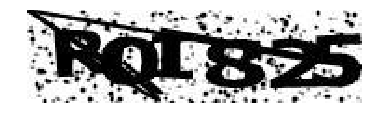

R O I 8 3 S 



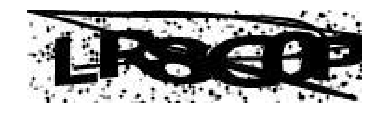

L R 8 G 0 P 



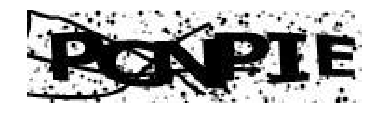

P C N P J E 



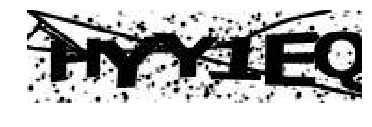

H Y Y 1 E Q 



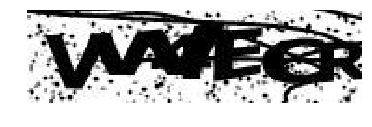

V V 4 E G R 



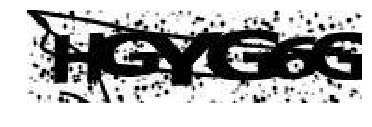

H G Y G 6 6 



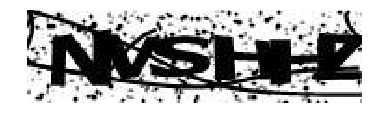

N V S H M Z 



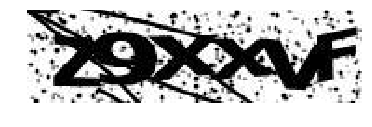

Z 9 X X V F 



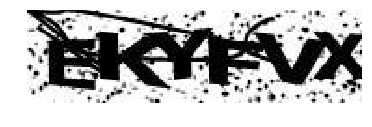

9 K Y P V X 



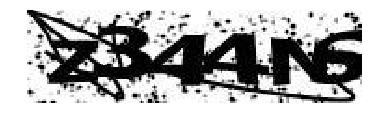

Z 3 4 4 N 5 



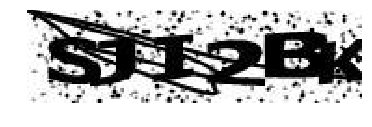

S J I 2 B K 



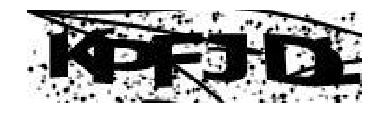

K P F J C L 



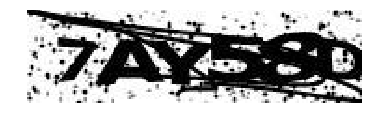

7 A Y S S 0 



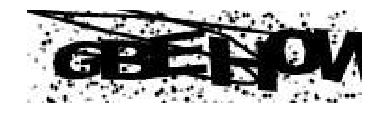

G B E H O V 



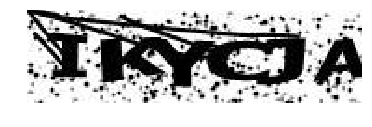

I K Y C J A 



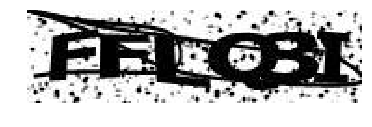

F F L Q 8 I 



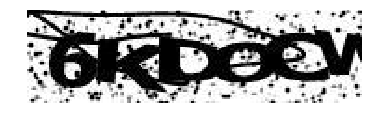

6 K D C G V 



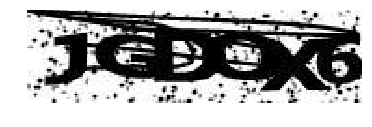

J G D O K 6 



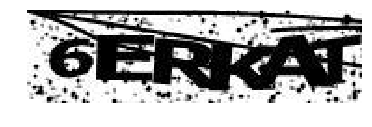

6 E R N A T 



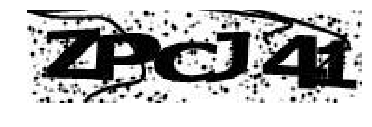

Z P C J 4 1 



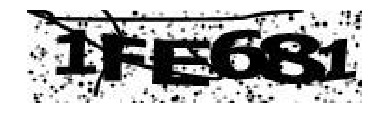

1 F E 6 8 1 



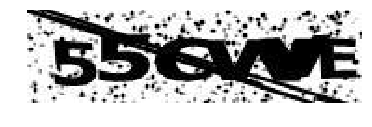

5 S 6 V W E 



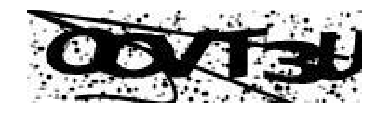

C O V T 3 U 



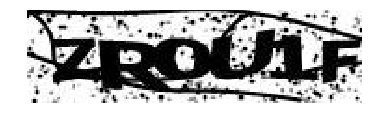

2 R 0 U 1 F 



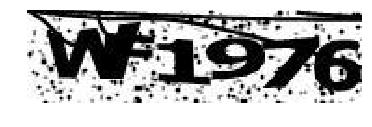

Y F 1 9 7 6 



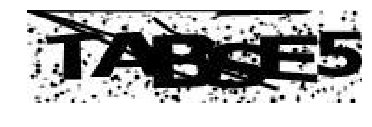

T A B 8 E 5 



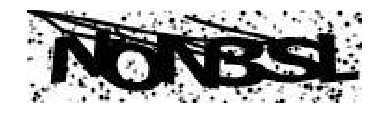

N O N B S L 



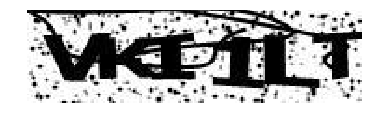

V K I 1 L T 



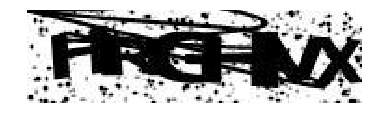

H R G H V X 



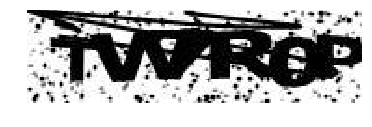

T V T R O P 



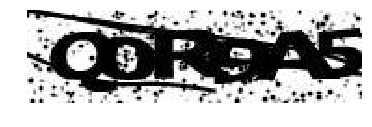

Q 0 R B A 6 



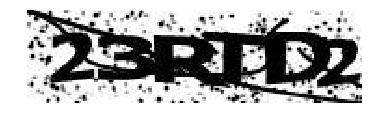

2 3 R J D 2 



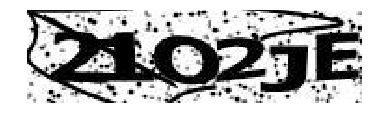

2 1 O 2 Y E 



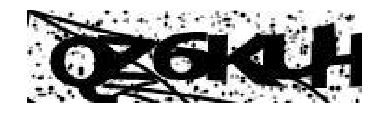

Q Z 6 K L H 



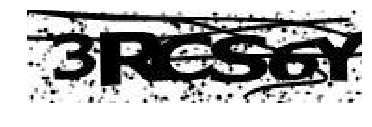

3 R C S 6 Y 



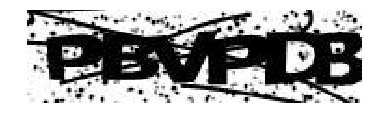

P B V P D B 



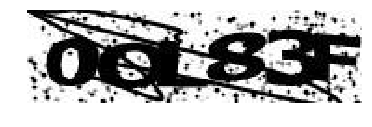

0 O L 8 3 F 



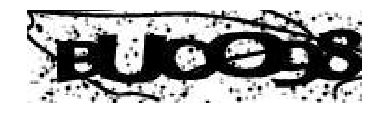

B U O C 2 8 



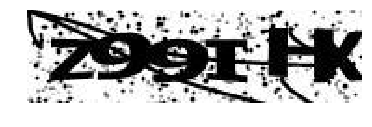

Z 9 9 I H K 



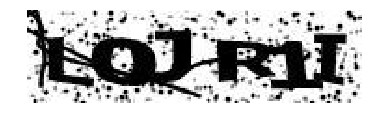

L 0 J T 1 I 



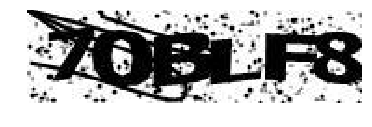

T 1 B L F 8 



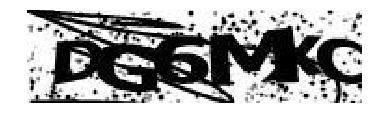

0 G 6 N Y O 



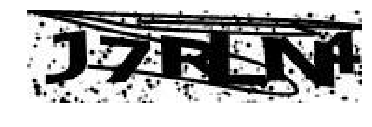

J 7 R L N 4 



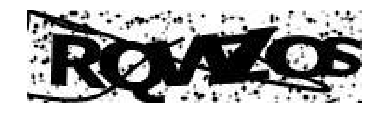

R Q V B O 5 



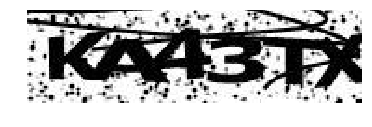

K 4 4 3 T X 



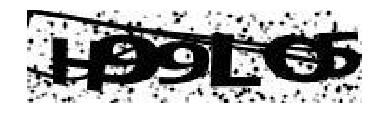

K 9 9 L Q 5 



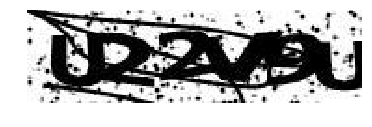

U 2 2 V 9 U 



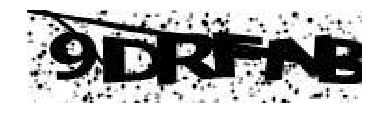

9 D R F N B 



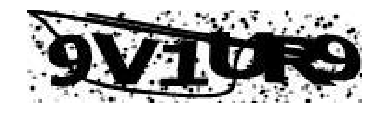

9 V 1 O R 9 



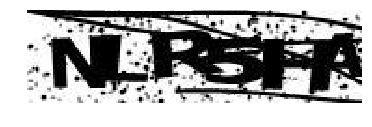

N L R S H 4 



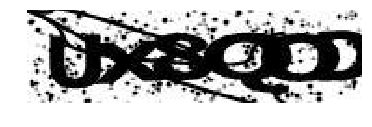

U X 8 Q D D 



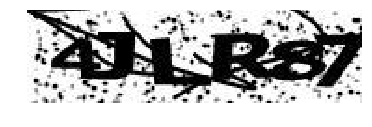

4 J L R 3 7 



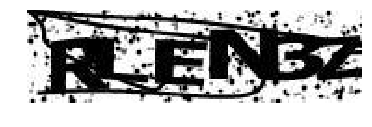

R L E N O Z 



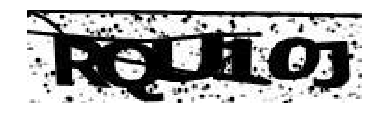

R Q U 1 O 1 



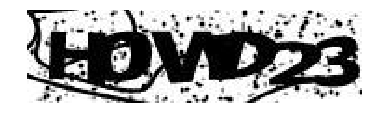

H J V Q 2 3 



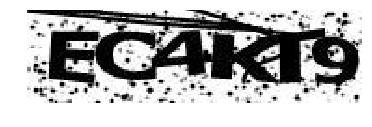

E C 4 K T 9 



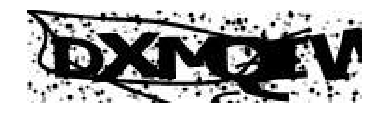

D X M Q 1 V 



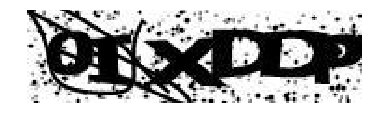

P L X D D P 



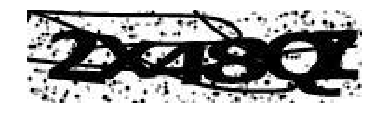

2 X 4 8 Q D 



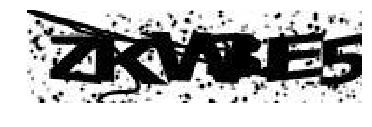

Z K V B E 5 



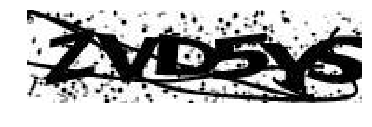

Z V D 5 Y S 



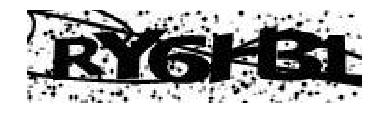

R Y 6 H B 1 



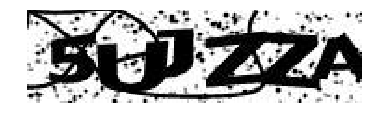

S U J Z 2 A 



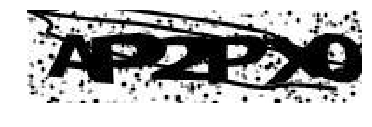

N P 2 P Y 0 



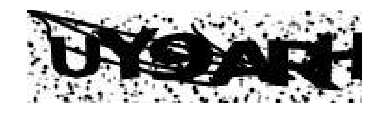

U Y 9 A F H 



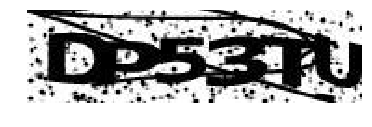

D P 5 3 T U 



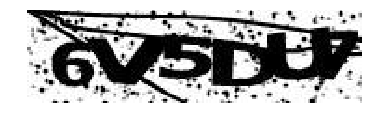

6 V 5 D L P 



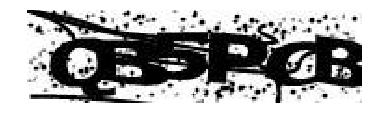

Q 8 5 P 7 B 



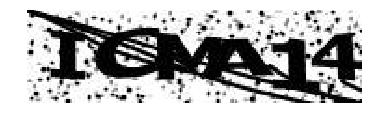

I C M A 1 4 



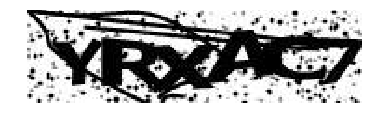

Y R X A O 7 



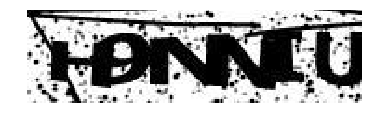

H 9 N N I U 



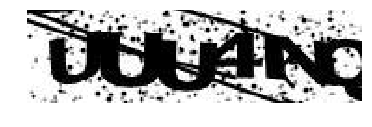

U U U 4 N Q 



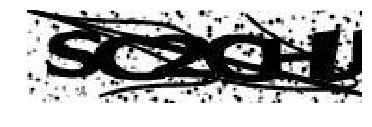

S C Z G L U 



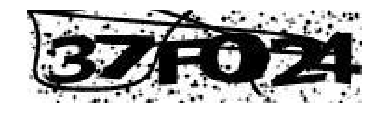

3 7 F 0 O 4 



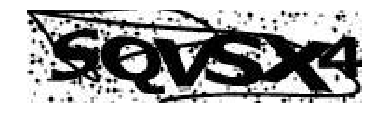

S Q V S X 4 



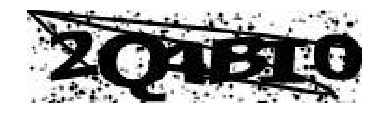

2 Q 4 B I 0 



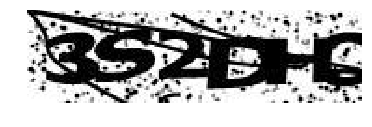

3 5 2 D M C 



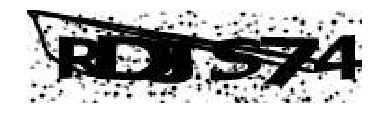

R D J S 7 4 



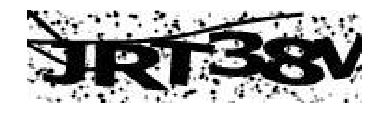

1 R T 3 8 V 



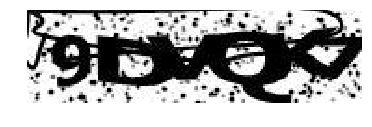

9 D V Q X 7 



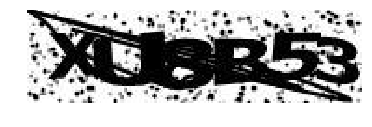

X U 8 B S 3 



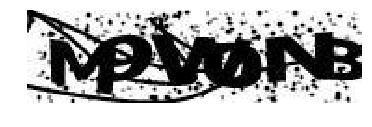

H 9 V 0 N B 



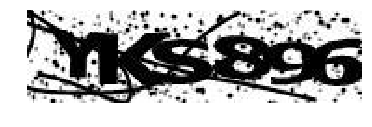

Y K S 8 9 6 



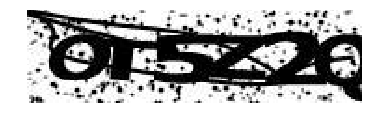

O T S Z 2 Q 



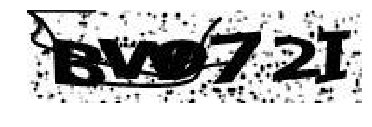

B V E 7 2 I 



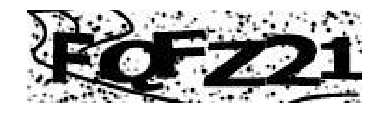

F Q F Z 2 1 



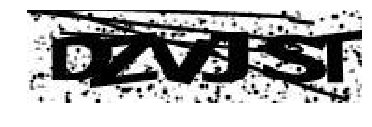

D Z V J S T 



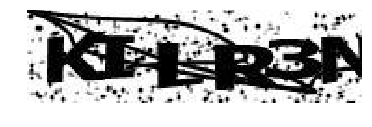

K I L B G N 



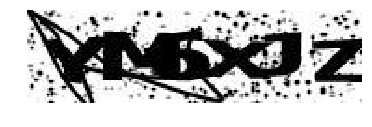

Y M 6 X J Z 



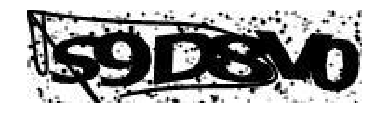

5 9 D 8 V 0 



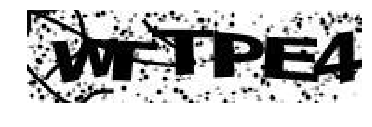

V T T F E 4 



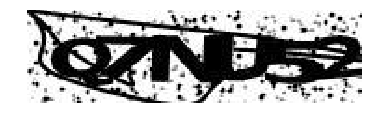

Q 7 N L 5 2 



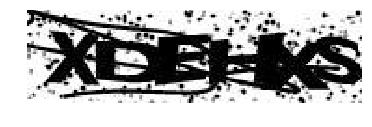

X O E H M S 



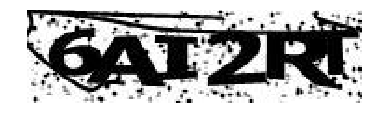

6 A 1 2 R I 



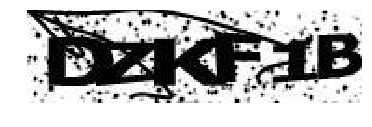

D Z K F 1 B 



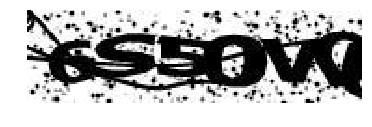

6 S 5 0 V 4 



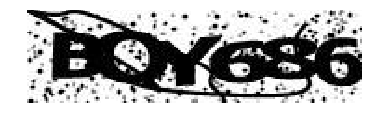

B O Y 6 8 6 



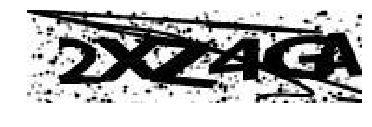

2 X Z 4 G A 



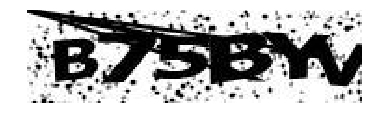

B 7 S B N V 



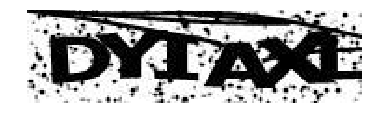

D Y I A X L 



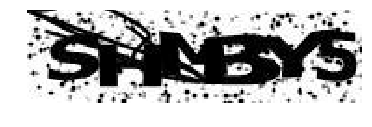

S N M B K 5 



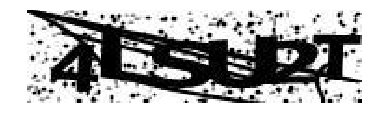

4 L S U D T 



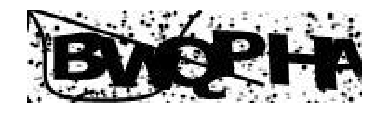

B V Q P H F 



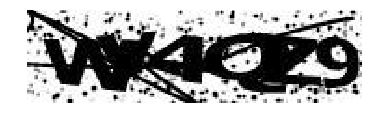

V Y 4 Q Z 9 



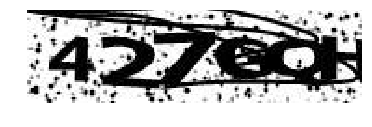

4 2 7 4 O K 



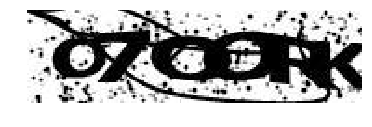

O 7 C O F K 



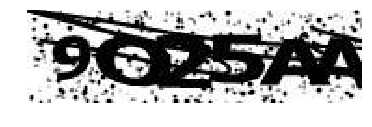

9 C 2 5 A A 



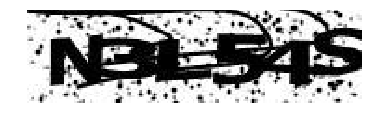

N 3 L S 4 S 



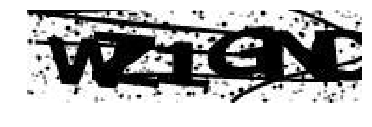

V Z 1 G N D 



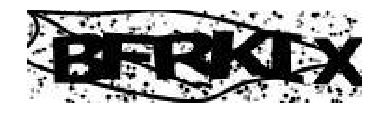

B F R K 1 X 



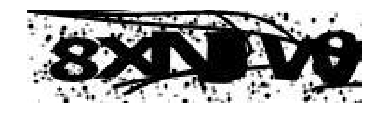

8 X N J V 9 



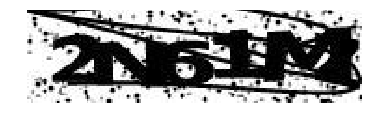

2 N 6 J A 1 



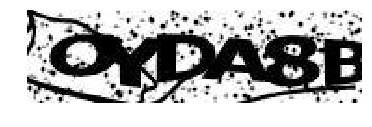

C Y D A 8 R 



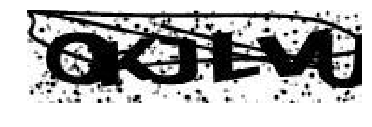

O K J L V U 



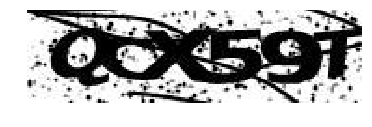

Q O X 5 9 T 



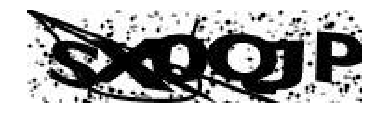

3 X 0 Q J P 



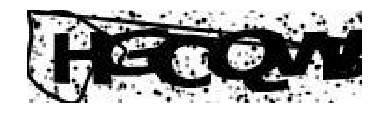

H G C Q V X 



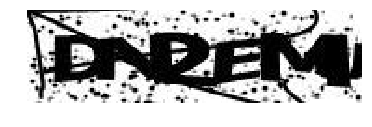

D N 2 E N 1 



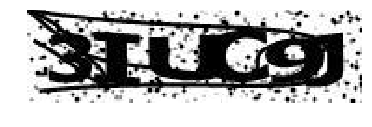

3 I U O 9 J 



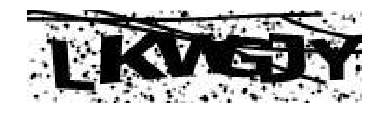

L K W G J Y 



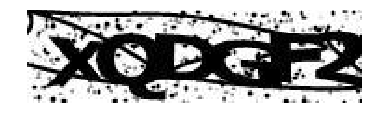

X Q D G F Z 



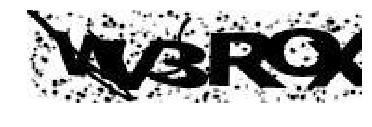

V U 3 R C X 



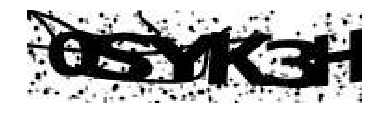

0 S Y K 3 H 



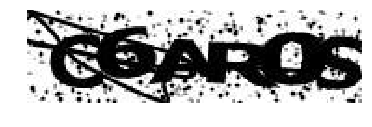

C 8 A R O 5 



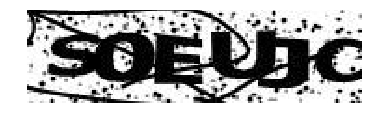

S 0 E L 2 O 



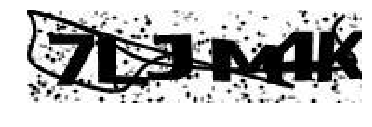

7 L J M 4 K 



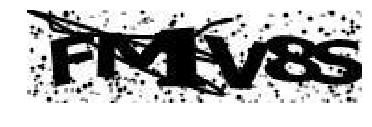

F M J V 8 S 



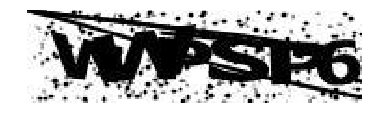

V V P S F 6 



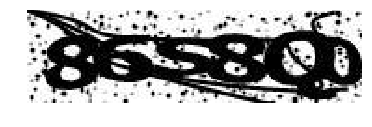

S 5 S 8 Q 0 



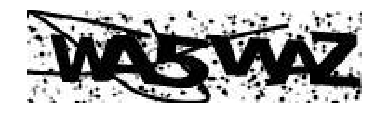

V A S V V Z 



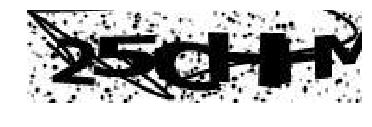

2 S O H H M 



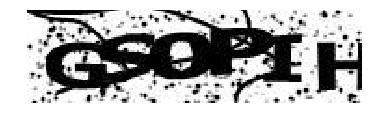

G 5 0 P J H 



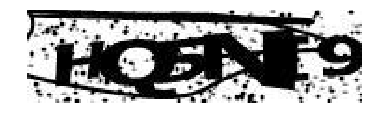

H Q 6 N 1 9 



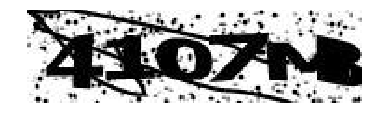

4 1 O 7 M X 



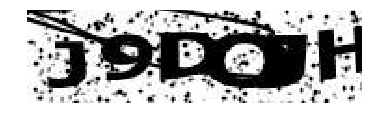

J 9 D C Y K 



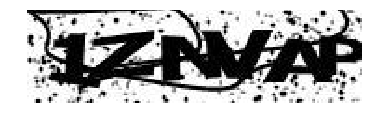

1 Z N V X P 



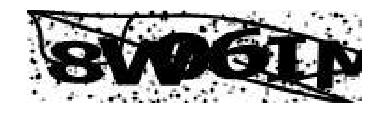

8 V B 6 1 M 



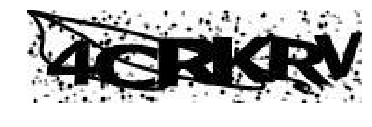

4 C R K R V 



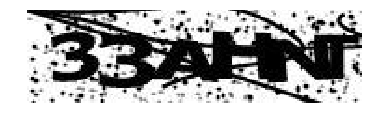

3 3 A H N T 



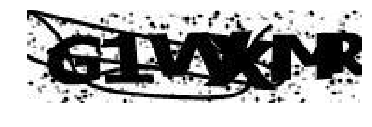

G 1 V X J R 



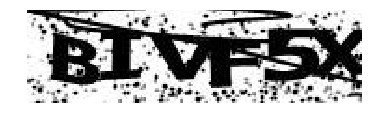

B I V F S X 



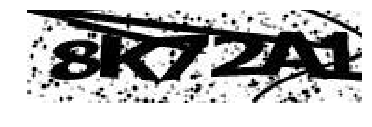

S K 7 2 A 1 



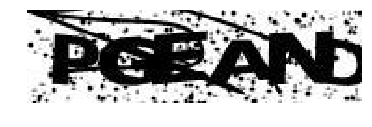

P G E A N D 



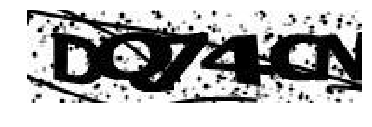

0 Q 7 4 O N 



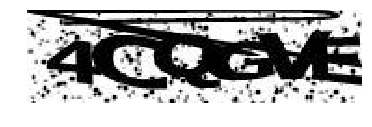

4 C Q G V 5 



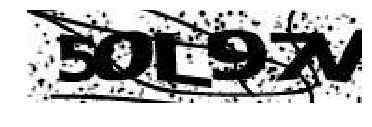

5 0 L 5 T V 



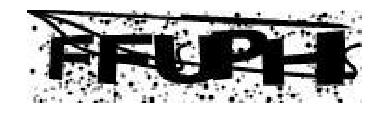

F F U P H 1 



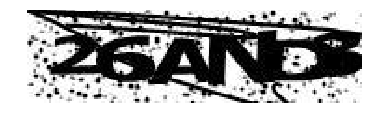

2 6 A N D 3 



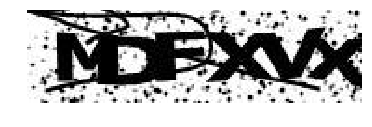

M D F X V X 



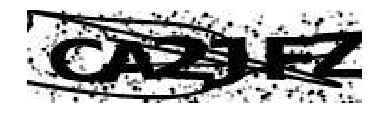

C A 2 J F Z 



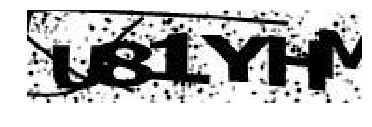

U 8 1 Y H M 



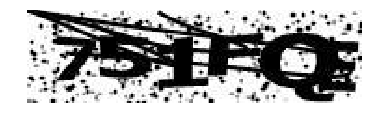

7 S 1 F Q E 



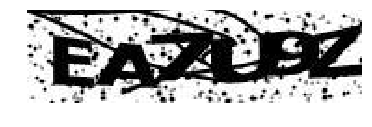

E A 7 L B Z 



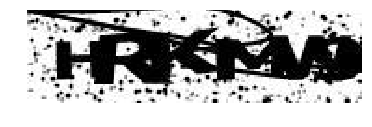

N R N M V 9 



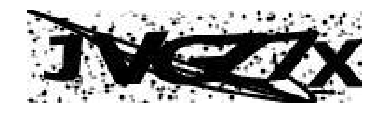

T V G Z 7 X 



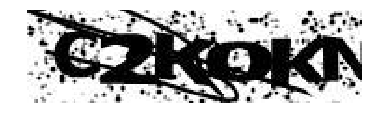

C 2 K O K N 



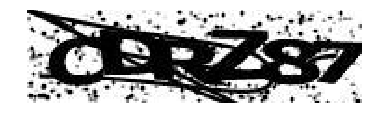

C D R Z 8 7 



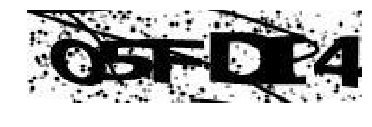

O 5 F D I 4 



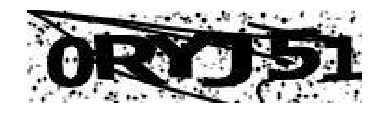

0 R Y J 5 1 



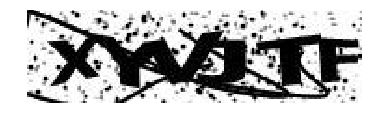

X Y U J T F 



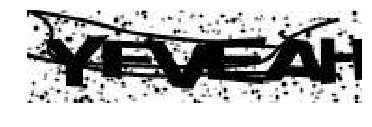

Y F V E 4 K 



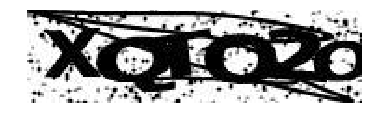

X Q T O 2 O 



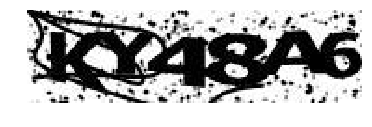

K Y 4 8 4 6 



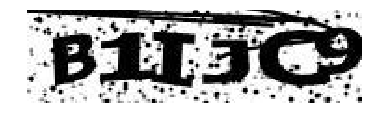

B 1 I J C 9 



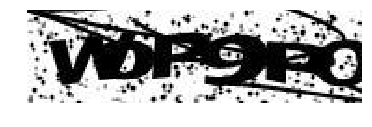

V 0 P 9 R O 



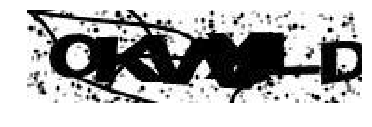

O K V X L O 



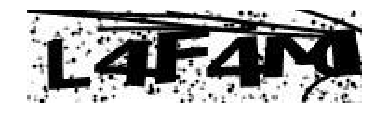

L 4 F 4 N 0 



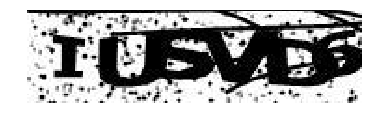

I U 5 V D 6 



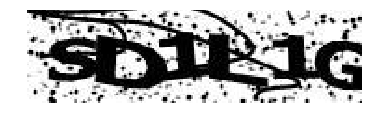

S D 1 L 1 G 



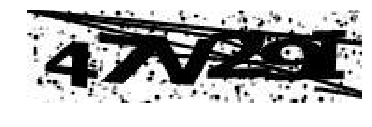

4 7 V 2 9 I 



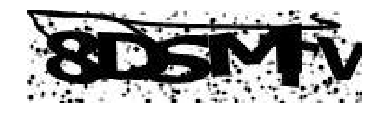

8 D 5 M T V 



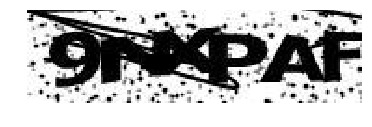

9 N X P A F 



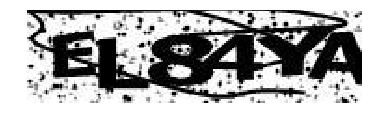

6 L 8 4 Y A 



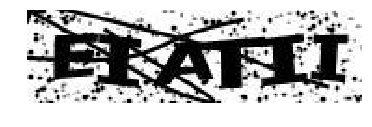

E I A T 1 I 



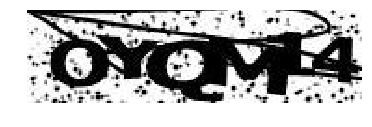

O Y Q N 4 4 



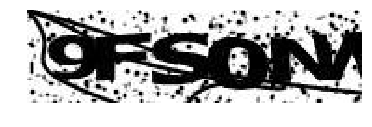

9 F S O A V 



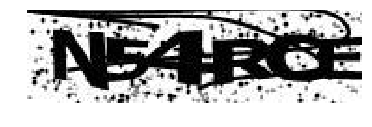

N 5 4 R O E 



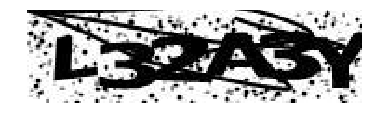

L 3 2 A 3 Y 



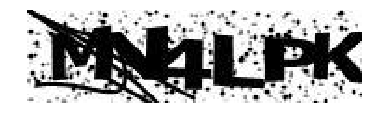

H M 4 L P K 



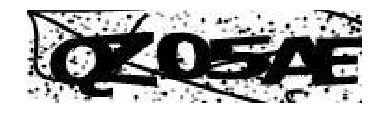

Q Z 0 S A E 



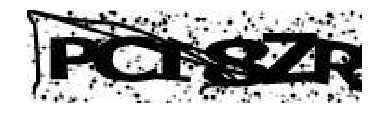

P C I 8 Z R 



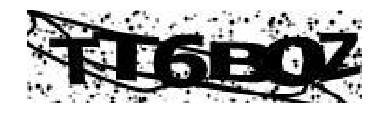

T T 6 B O D 



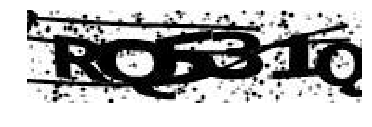

R Q 6 3 1 Q 



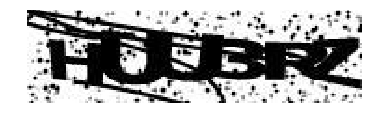

H U U D R Z 



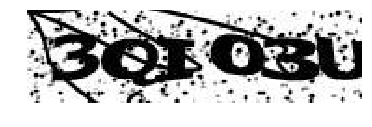

3 Q J 0 3 U 



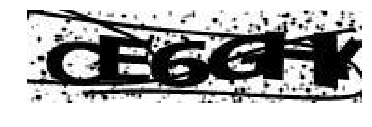

C E 6 G H Y 



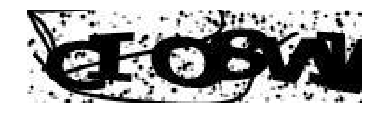

C I C B V B 



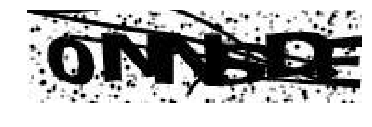

1 N N 8 O E 



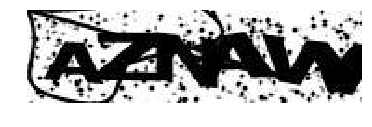

A Z N A V Y 



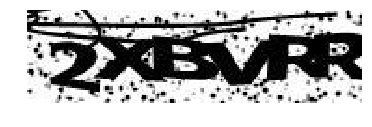

2 X B V R R 



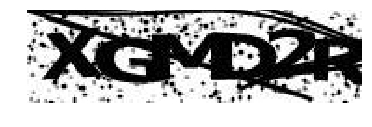

N G M D 2 R 



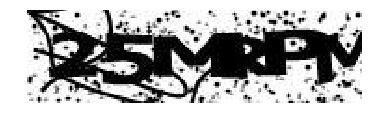

2 5 M A F M 



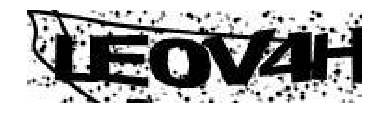

U E 0 V 4 H 



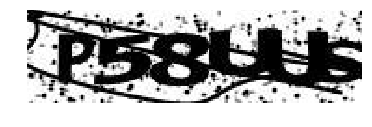

P 5 8 L U 8 



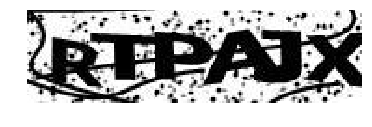

F T P A J X 



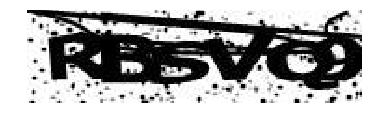

R B 5 V O 9 



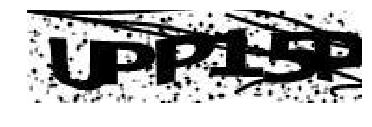

U P P 1 S P 



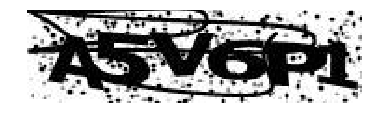

A 5 V 6 F 1 



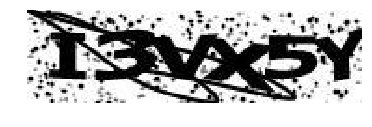

I 3 V X S Y 



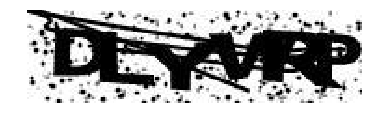

D L Y V R P 



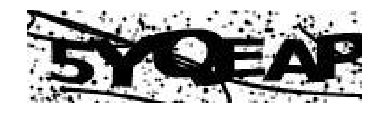

S Y O E A P 



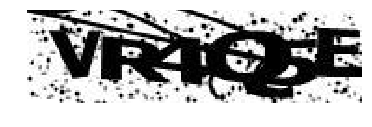

V R 4 Q 8 E 



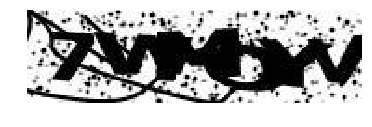

T V M I Y V 



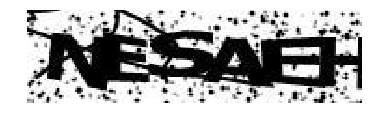

N E S A E H 



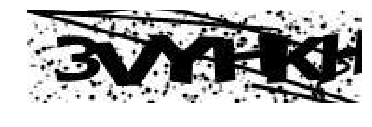

3 V Y H K K 



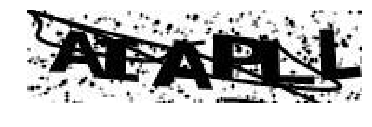

4 I A P L L 



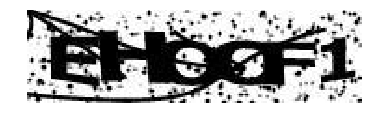

E H Q C F 1 



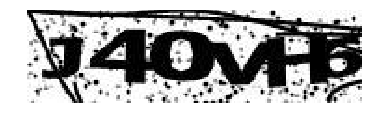

I 4 0 V H H 



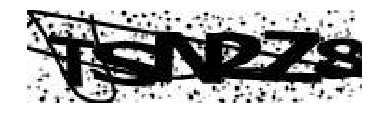

T S N 2 2 8 



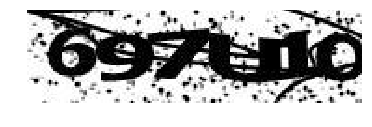

G 9 7 L 0 O 



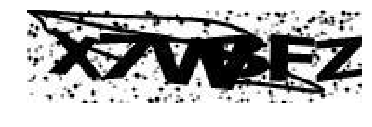

X 7 V B F Z 



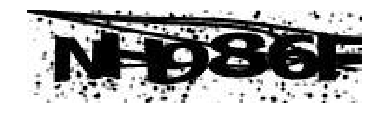

N H 9 8 6 F 



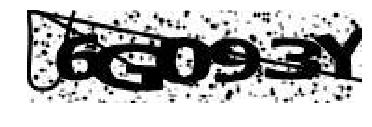

6 G 0 9 3 V 



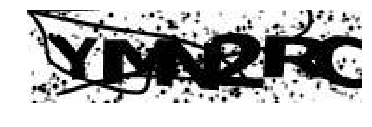

Y N N 2 R C 



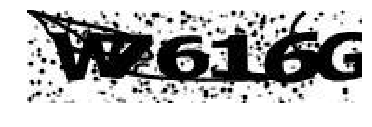

V 7 6 1 6 G 



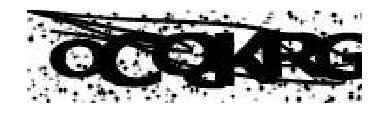

O C Q K R 6 



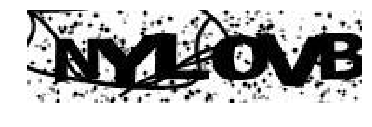

K Y L O V B 



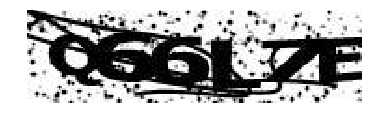

Q 6 6 L 7 E 



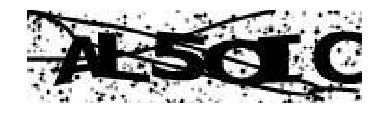

A L 5 C I C 



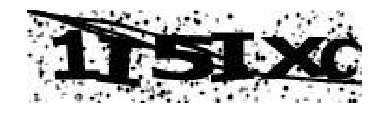

1 I S 1 X O 



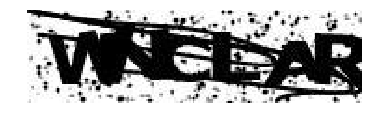

V N C D X R 



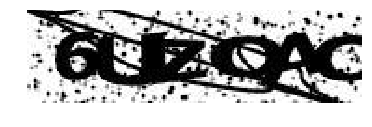

6 U Z O R C 



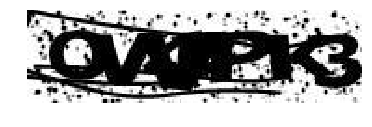

O V B P V 3 



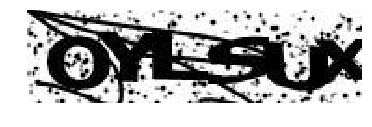

O Y L 5 U K 



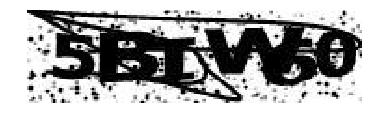

5 8 1 W W 1 



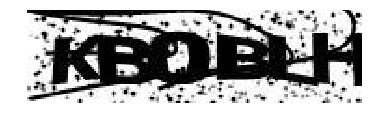

K 8 0 B L H 



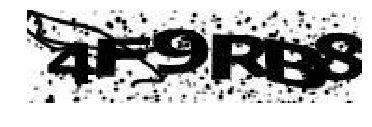

4 F 9 R B B 



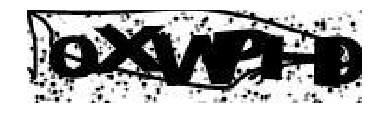

0 4 V F H 9 



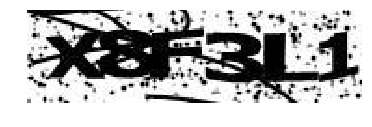

X 5 F 3 L 1 



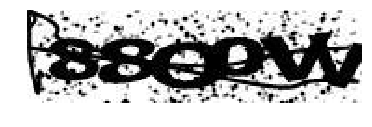

8 8 G 0 V V 



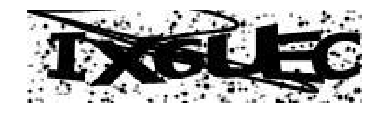

I X 6 L E C 



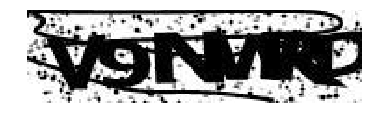

Y 9 N V P I 



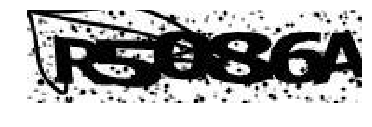

R S 0 8 6 A 



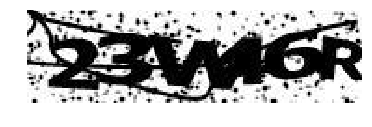

2 3 V 4 6 R 



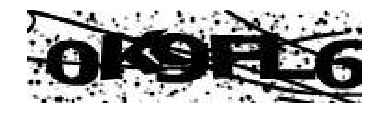

0 K 9 F L 6 



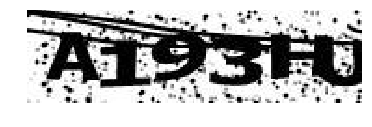

A 1 9 3 H U 



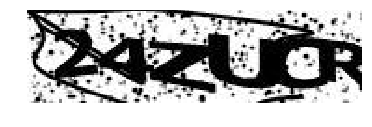

2 4 Z L C R 



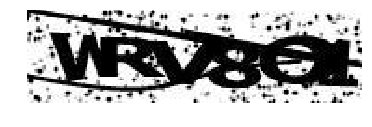

V R 0 8 G V 



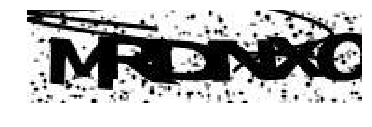

M R D N R O 



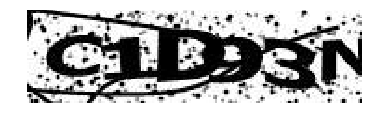

C 1 D 9 2 N 



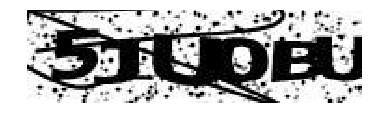

5 J U O T U 



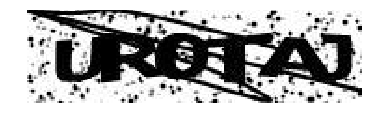

U R 0 T A J 



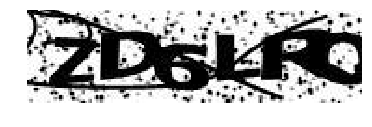

2 D 6 L F O 



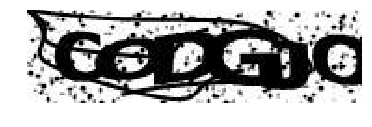

O O O G 0 O 



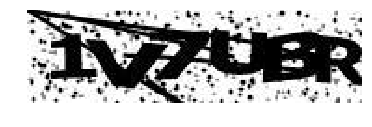

I U 7 V B R 



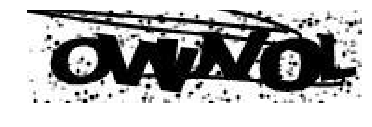

O V V V Q L 



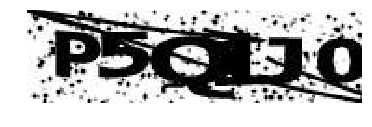

P 5 Q A J 0 



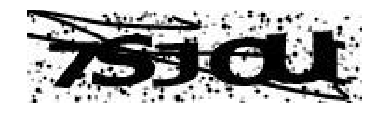

7 S J C L I 



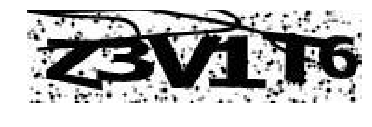

Z 3 V 1 T 6 



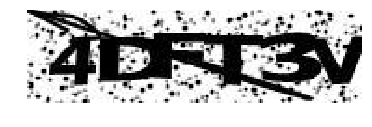

4 D F T 3 V 



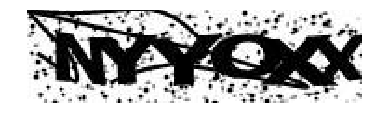

N Y Y O X X 



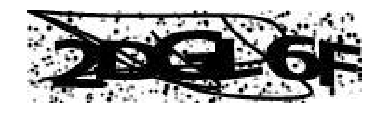

2 D G L 6 R 



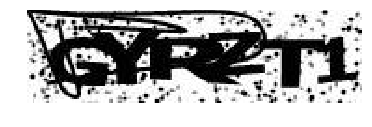

G Y R Z T 1 



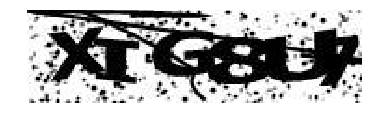

X I G 5 L F 



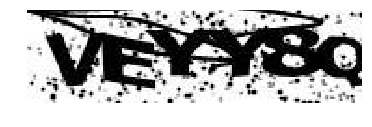

V E Y Y 8 Q 



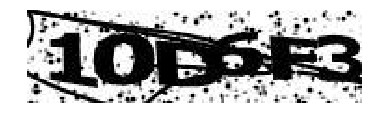

1 0 D 6 F 3 



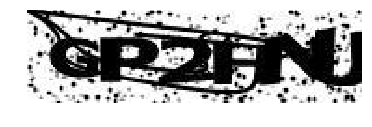

G P 2 M N U 



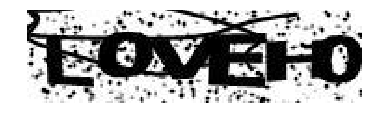

L 0 V E M 0 



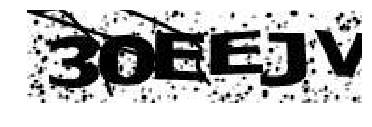

3 0 E E J V 



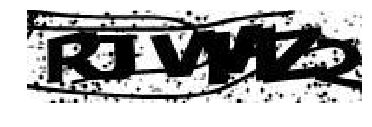

R J V K 2 2 



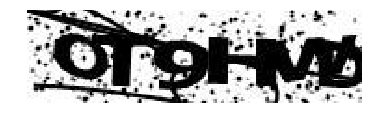

O T 9 H V B 



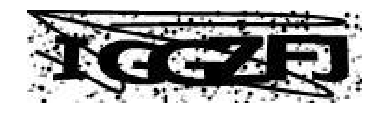

I G G Z F J 



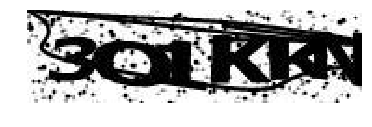

3 O 1 K K N 



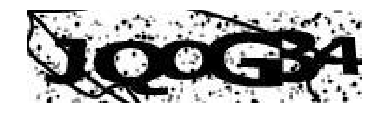

J Q O G 8 4 



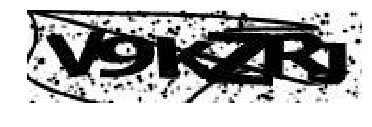

V 9 K Z H J 



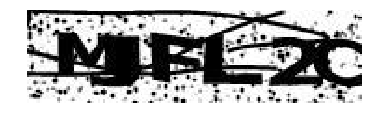

M 1 F L 3 C 



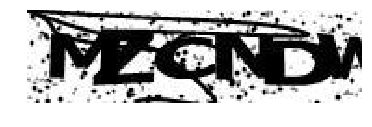

M D C N D V 



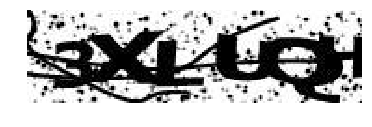

3 X L U Q H 



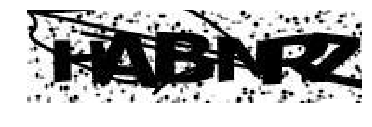

H A B N R Z 



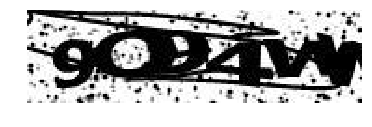

9 O V 4 V Y 



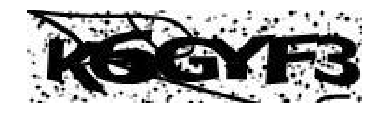

K 5 G Y F 3 



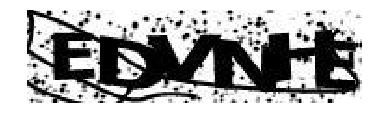

E D V N H E 



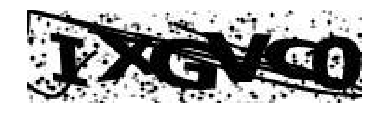

I X G V Q 0 



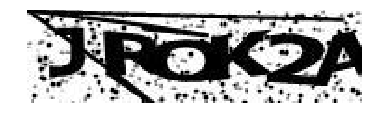

J H C K 2 A 



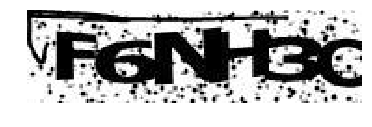

F 6 N H G C 



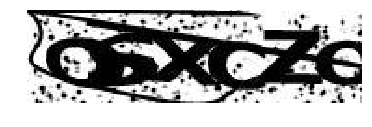

O 6 X C Z G 



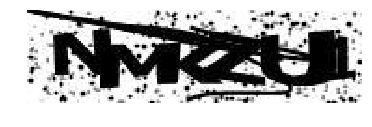

N M R Z L 1 



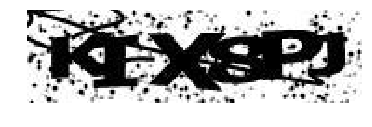

K I X 8 P J 



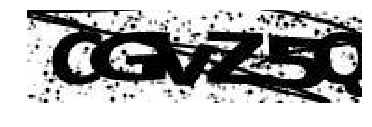

O G V Z S Q 



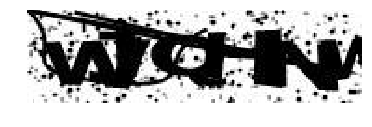

W J Q H M V 



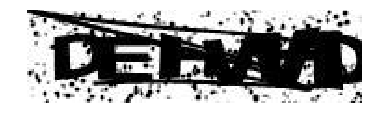

D E H V V D 



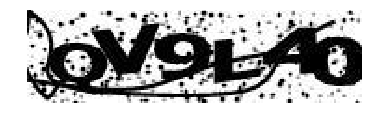

Q V 9 L 4 0 



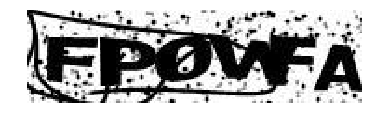

F P 0 V F X 



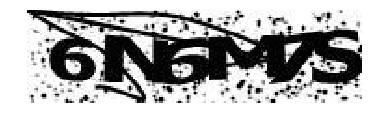

6 N 6 M 7 S 



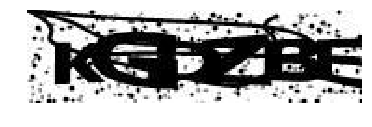

K G D Z B E 



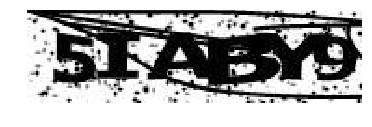

S I A B K 9 



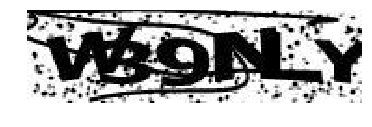

V 3 9 N L Y 



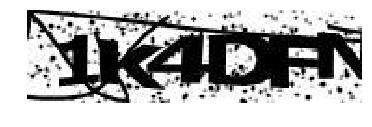

1 K 4 D F N 



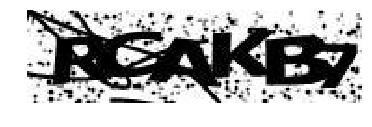

R C A K B Y 



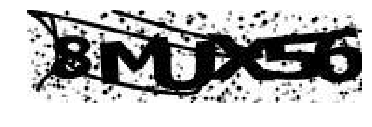

5 M U X 5 6 



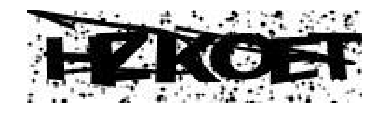

H D K O E T 



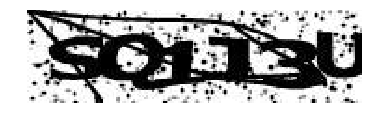

S Q 1 J 3 U 



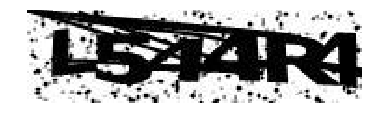

U 5 4 4 F A 



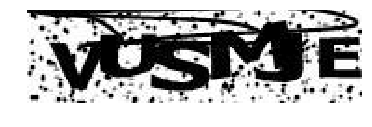

V U 5 T J E 



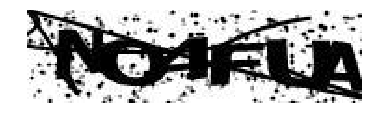

N O 4 F U A 



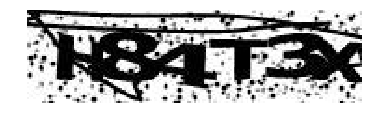

H 8 4 T 3 X 



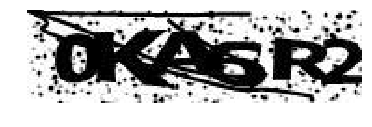

0 N A 6 N 2 



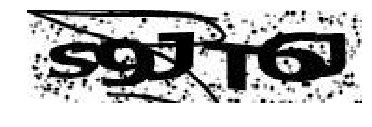

S 9 J Y 6 J 



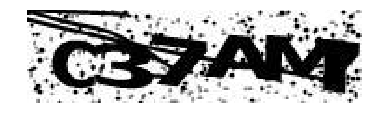

C 3 7 A N T 



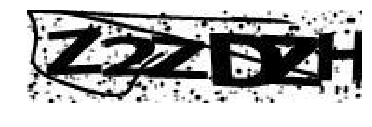

Z 2 Z C 2 H 



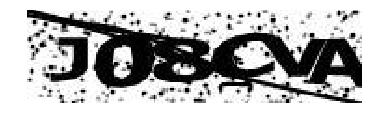

J 0 8 O V A 



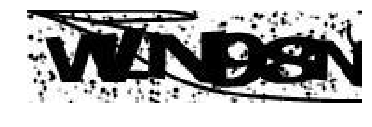

V 1 N 9 8 N 



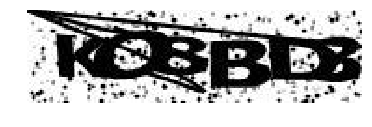

K C 8 B D 3 



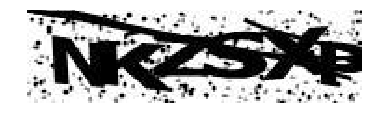

N K Z S X 4 



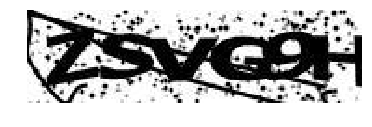

2 S V G 9 H 



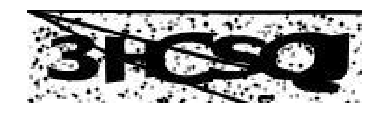

3 H C S Q J 



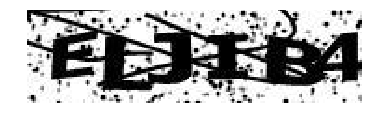

E L J I B 4 



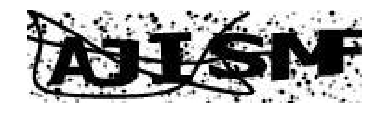

A J I 5 N F 



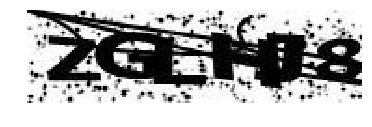

Z G L M J 8 



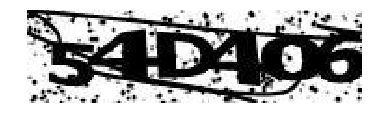

5 4 D 4 O 6 



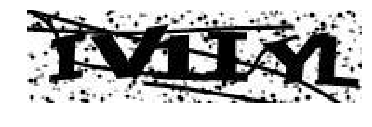

I W 1 I Y L 



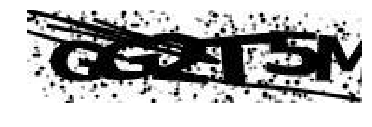

G G Z T E M 



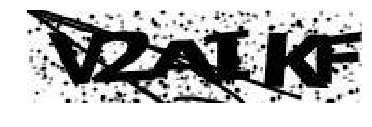

V Z A I K F 



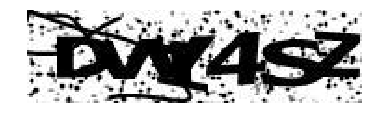

O V Y 4 5 Z 



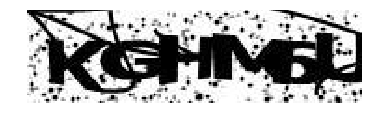

Y G H N G U 



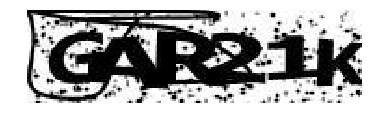

G A R 2 1 K 



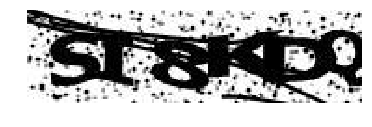

S I 8 K D 0 



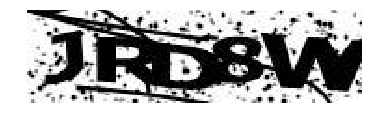

J R E 8 V Y 



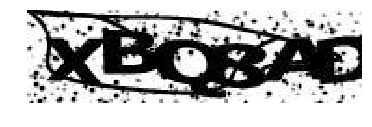

X 8 Q 8 X D 



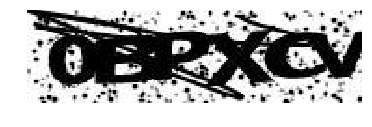

0 B P X C V 



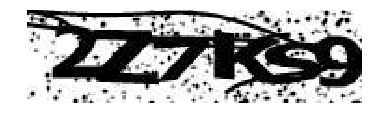

7 Z 7 K 5 9 



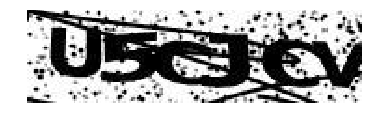

U 5 C J C V 



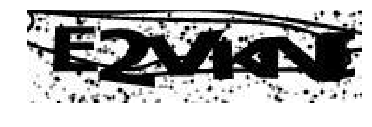

E 2 V K N J 



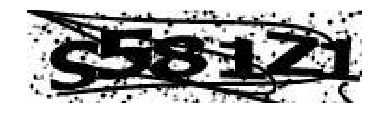

3 5 8 1 2 1 



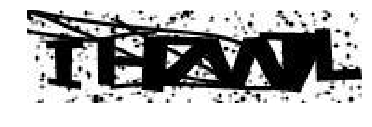

I N 7 V B L 



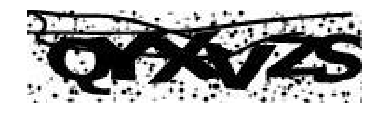

Q Y X U Z S 



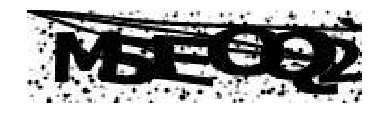

M 5 E O Q 9 



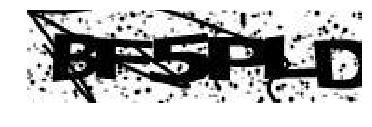

B F 5 P L D 



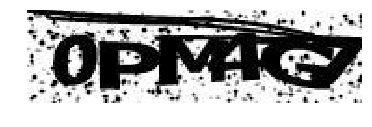

0 P M R G 7 



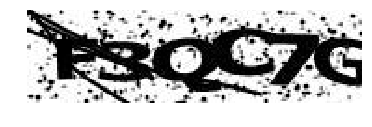

F S Q O 7 G 



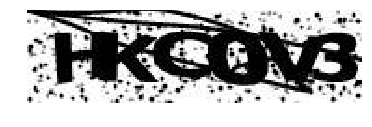

H K C 0 V 3 



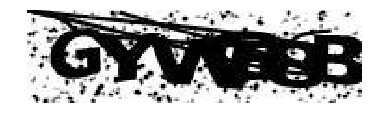

G Y V P 6 B 



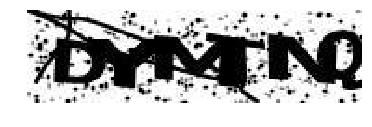

0 Y M T N 0 



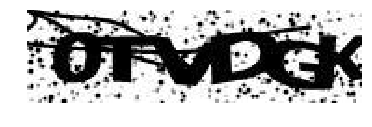

0 T V C Q K 



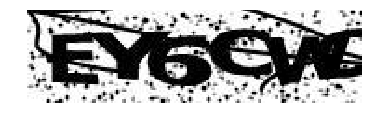

E Y 6 G V G 



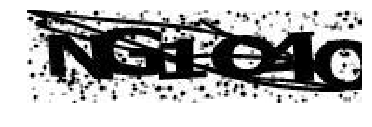

N G 1 C 4 O 



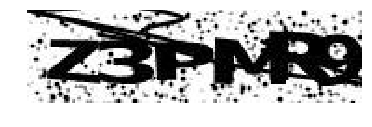

Z 3 P M F 9 



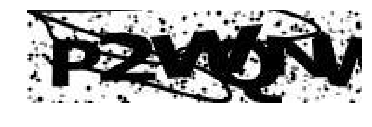

P 2 V O M V 



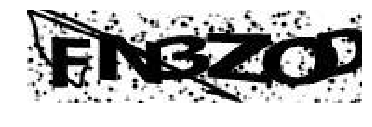

F N 3 Z O P 



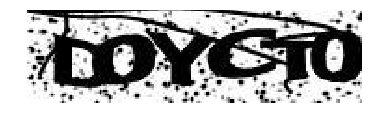

D 0 Y C T 0 



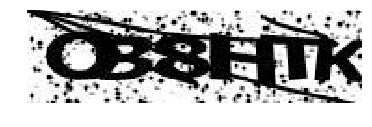

O 8 8 H N K 



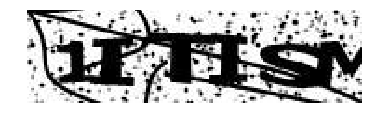

1 I T I S M 



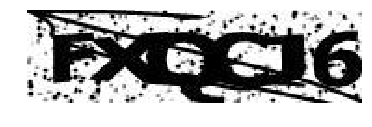

F X Q C J 6 



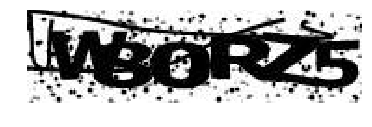

V 8 0 R Z S 



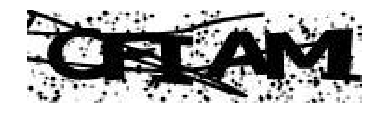

C F I A N 1 



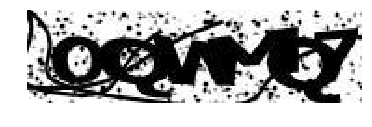

O Q V M Q T 



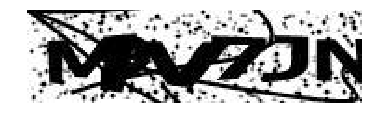

V P L 7 J N 



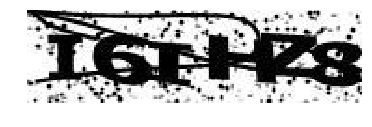

I 5 I H Z 3 



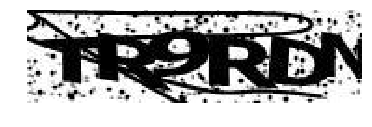

T R 9 R D N 



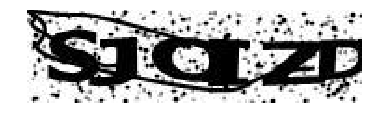

S J C I 2 D 



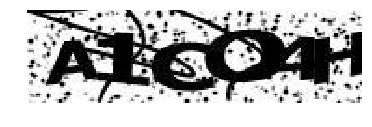

A 1 C O M H 



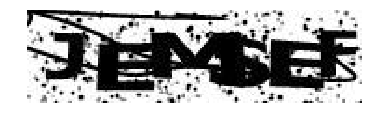

J B M 8 5 F 



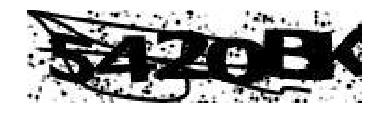

5 4 2 0 B K 



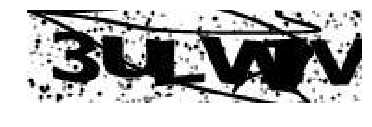

3 U L V B V 



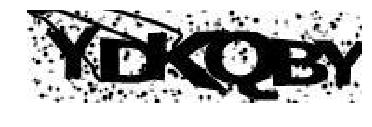

Y D N Q I Y 



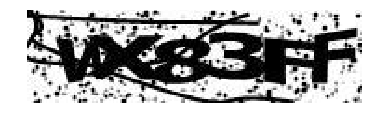

V X S 3 F F 



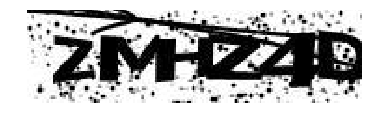

2 M H Z 4 0 



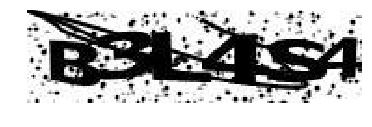

8 3 L 4 S 4 



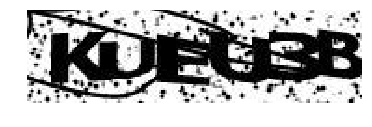

K U E U G 8 



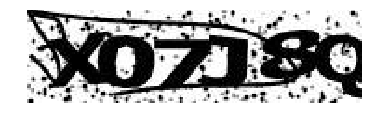

X 0 7 J S Q 



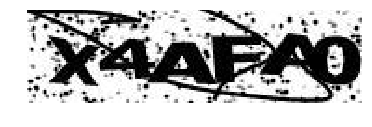

Y 4 A F 4 0 



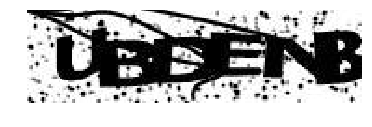

U B D E N B 



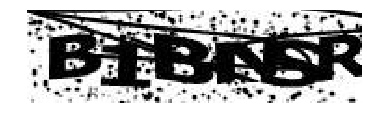

B 1 B A 5 R 



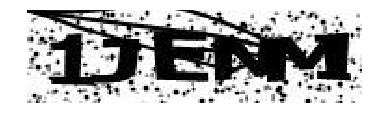

1 J E N N 1 



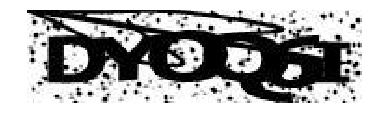

D Y D Q 8 I 



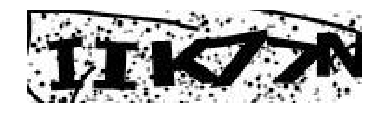

I I K 7 7 N 



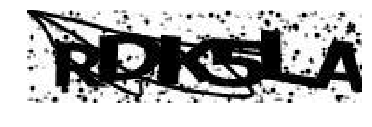

R D K 5 L A 



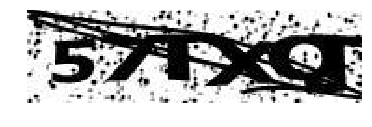

S 7 T X O T 



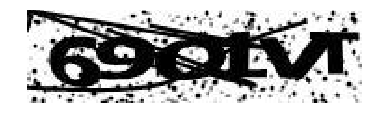

6 9 C 1 V T 



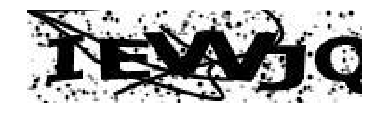

I E V V Y Q 



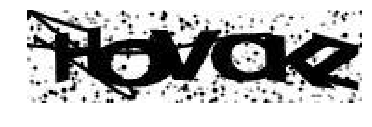

K O V O K Z 



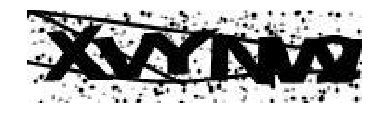

X V Y N V W 



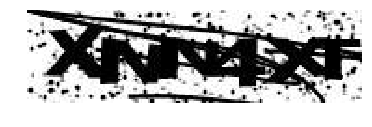

X N N 4 7 T 



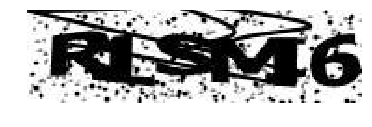

R L S N 1 6 



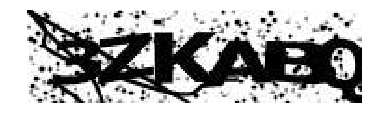

3 Z K A E Q 



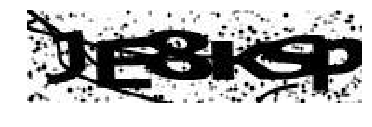

J E 8 K S P 



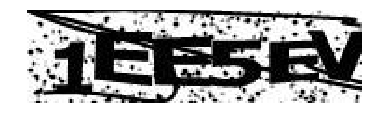

T E E 5 E V 



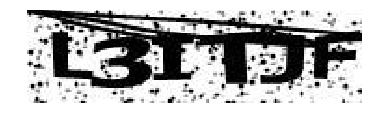

L 3 I T J F 



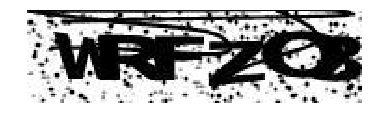

V R F 2 C 8 



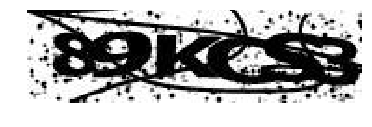

3 7 K C S 3 



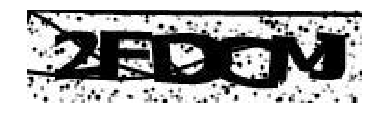

2 F D C A 1 



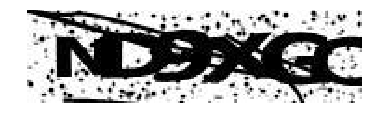

N D 9 X G C 



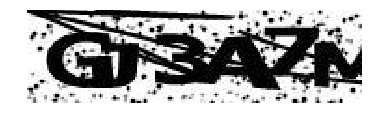

G J 3 A 7 N 



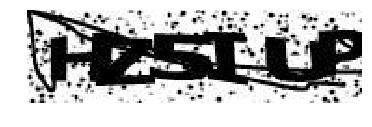

H Z S I U P 



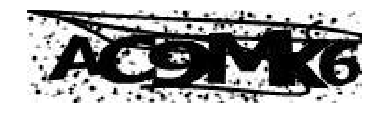

A O 9 N K 8 



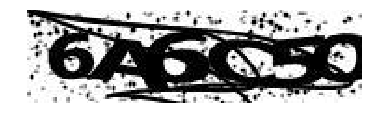

6 A 6 O 3 O 



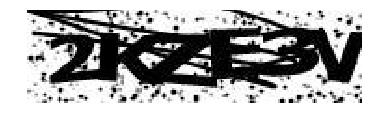

2 K Z E 3 V 



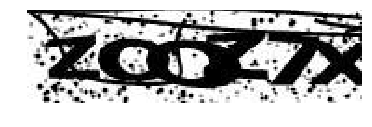

Z O C Z 7 X 



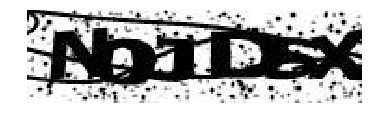

N 0 J D 8 X 



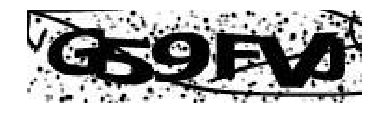

G S 9 F V J 



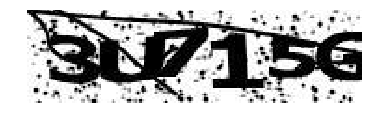

3 U 7 1 5 G 



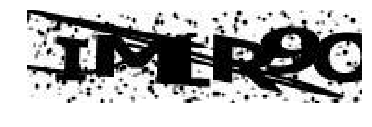

I M 1 R B O 



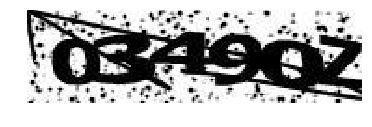

0 3 4 9 Q Z 



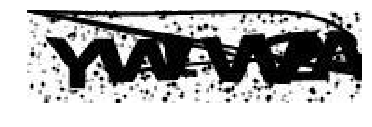

Y V I V B A 



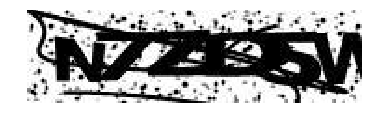

N 7 Z C 5 V 



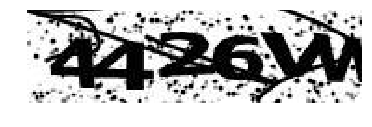

4 4 2 6 V V 



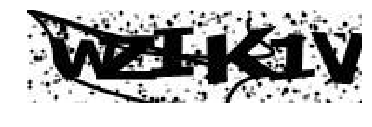

V Z I K 1 V 



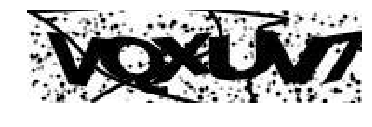

V Q X U V T 



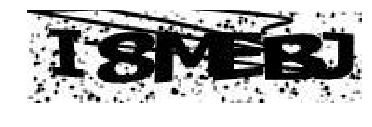

I 8 M B B J 



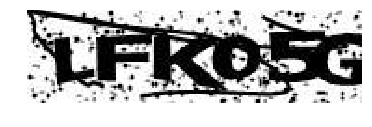

L F K 0 S G 



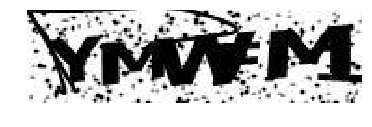

Y M V Y N 1 



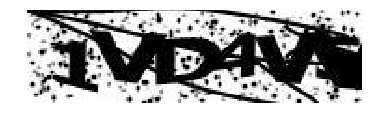

1 V D 4 V A 



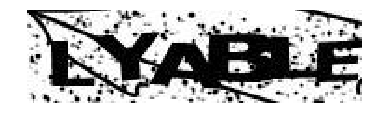

L Y A B L E 



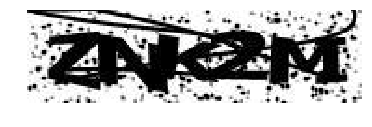

Z N K 2 N I 



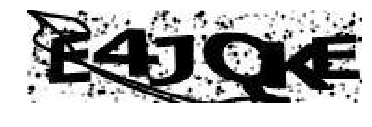

E 4 J Q K E 



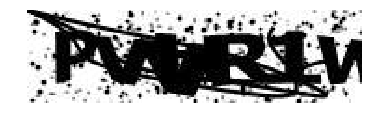

P V W R 1 V 



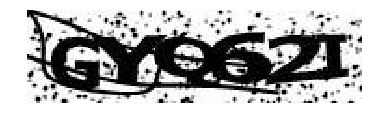

C Y Q 6 2 I 



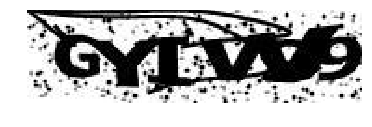

G Y I V V 9 



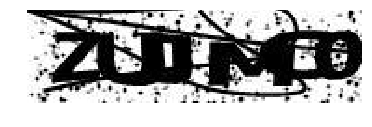

Z U J N Q 0 



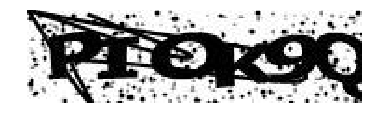

P I C K 9 Q 



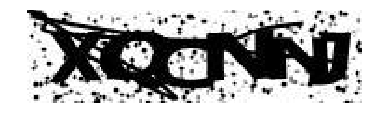

X Q C N M J 



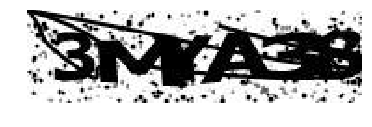

3 M Y A 3 8 



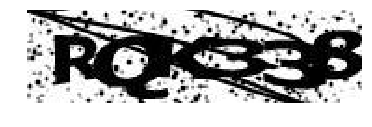

R Q K 3 3 8 



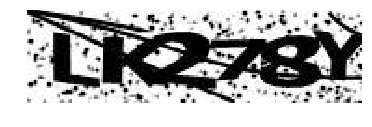

L K Z 7 8 Y 



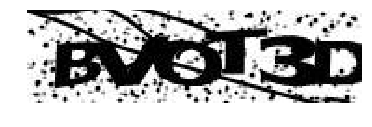

B V C T 3 D 



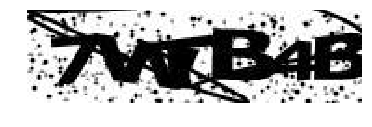

7 V T B 4 8 



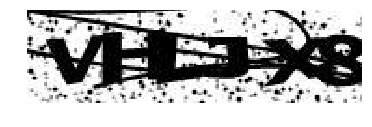

V H L J X 8 



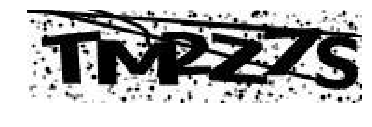

T M P Z 7 5 



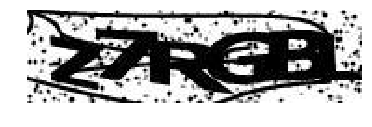

Z 7 R G E L 



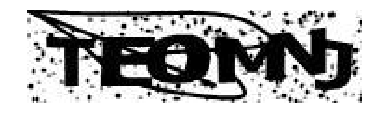

T E 0 N N J 



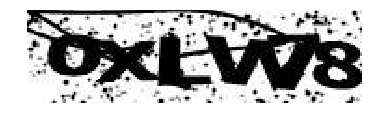

0 X L V V 8 



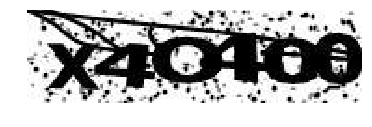

Y 4 O 4 0 0 



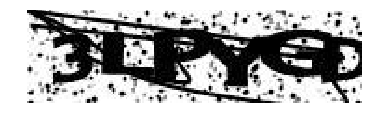

3 U F Y G D 



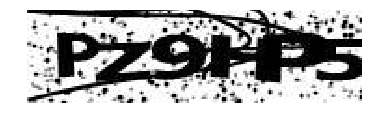

P Z 9 H P 5 



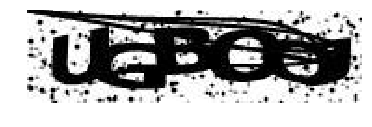

U G P G O J 



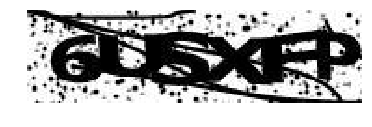

6 U 5 X F P 



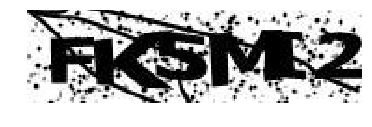

F K S M 1 2 



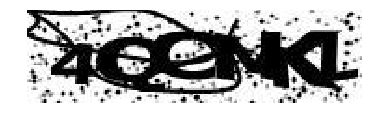

4 Q C M K L 



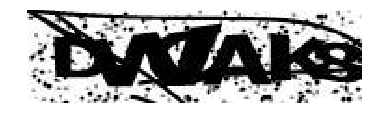

D V B A K 8 



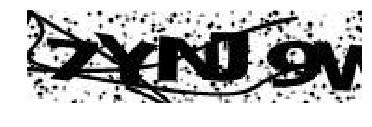

7 Y N J 9 Y 



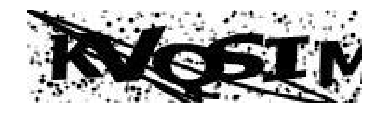

K V Q 6 T M 



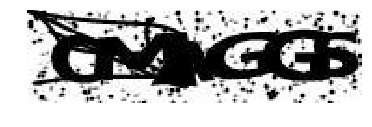

O M A G G 5 



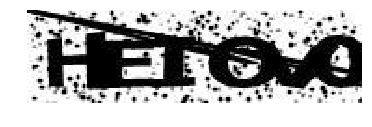

K E I O H 0 



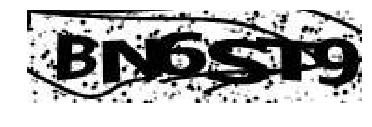

B N 6 S T 9 



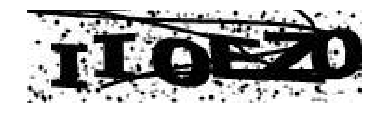

T I 0 E Z D 



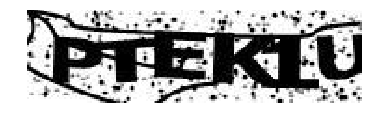

P T E K 1 U 



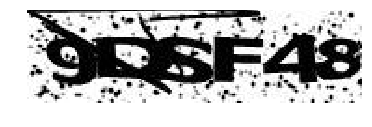

9 D 5 F 4 8 



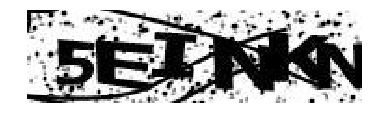

5 E I N K H 



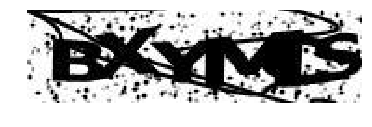

B X Y N 8 S 



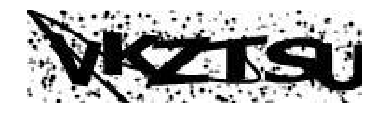

V K Z T S U 



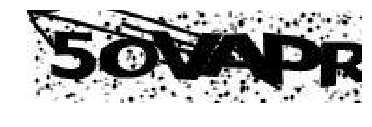

5 O V A P R 



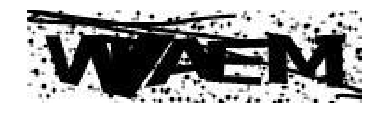

V A A E N T 



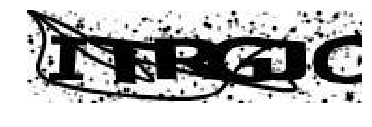

I T R G 1 C 



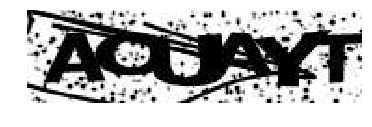

A C U A Y T 



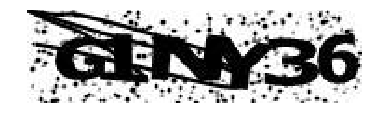

G 1 N Y 2 6 



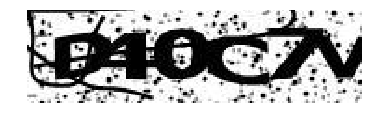

0 4 0 C 7 V 



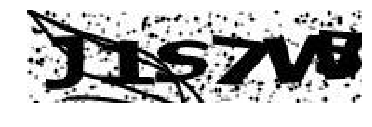

J 1 S 7 V P 



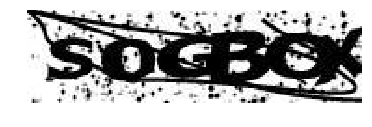

S 0 G B G X 



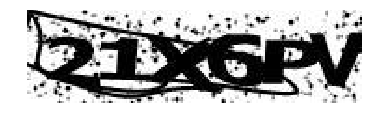

Z 1 X 6 P V 



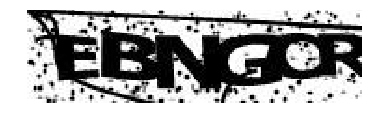

E B N G D R 



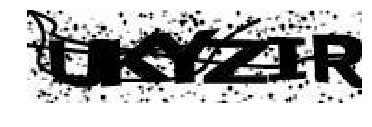

U K Y Z J R 



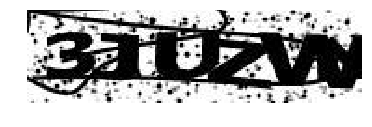

3 J U Z V K 



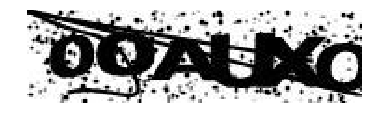

0 0 A U K O 



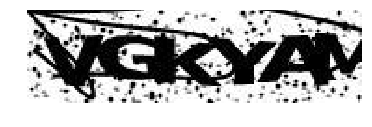

V G K Y A M 



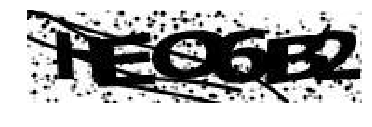

H E C 6 D 2 



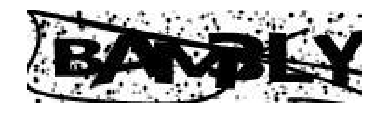

B A N 3 L Y 



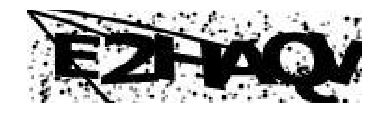

E 2 H A Q V 



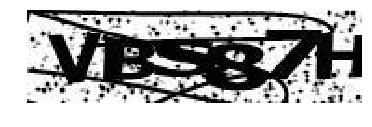

V B S 8 7 H 



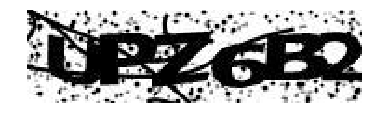

U P Z 6 B 2 



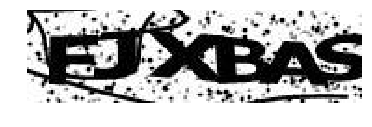

F J X D A S 



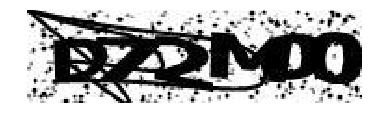

D 7 2 N 0 0 



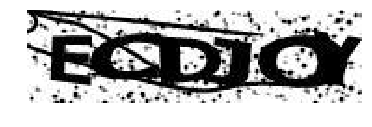

5 C D 1 C Y 



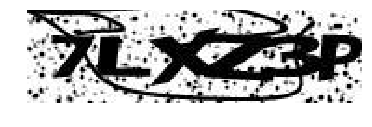

T L X Z 3 P 



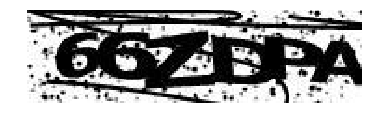

6 6 Z D P A 



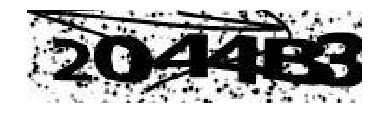

2 0 4 4 B 3 



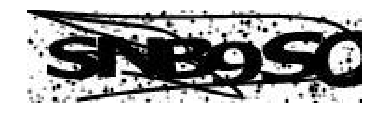

S N B 9 S O 



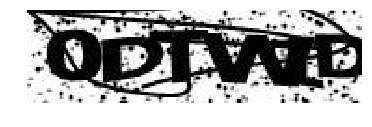

D D T V Y D 



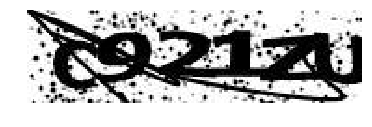

C 9 2 1 Z U 



In [10]:
#computa resultado
cont = 0
acertos = [0,0,0,0,0,0,0]
arquivos = glob.glob(helper.link+helper.local_teste)
x_ini = 0
x_fim = 6
for imagem in arquivos:
    #mostra imagem
    img = cv2.imread(imagem,0)
    plt.imshow(img,cmap = 'gray')
    plt.axis("off")
    plt.show()
    
    #separa as posições no label e no prediction referentes a imagem
    aux_pred = prediction[x_ini:x_fim]
    aux_label = y_test[x_ini:x_fim]
    x_ini = x_fim
    x_fim += 6
    
    #atualiza resultado e imprime o que foi predito
    igual = 0
    acertos[igual] += 1
    for x in range(6):
        if aux_pred[x] == aux_label[x]:
            igual += 1
            acertos[igual] += 1
        print "%s" %(helper.map[aux_pred[x]][0]),
    print "\n"
    cont += 1   

valores brutos:[1000, 1000, 998, 976, 874, 620, 260]


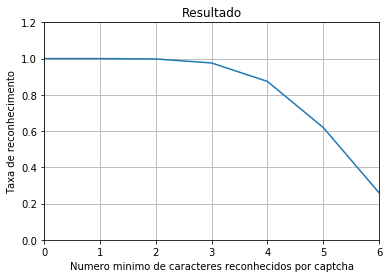

In [11]:
print "valores brutos:" + str(acertos)
acertos = np.array(acertos).astype('float32')

plt.plot([0,1,2,3,4,5,6],[float(acertos[0]/acertos[0]), float(acertos[1]/acertos[0]), float(acertos[2]/acertos[0]), 
                          float(acertos[3]/acertos[0]), float(acertos[4]/acertos[0]), float(acertos[5]/acertos[0]), 
                          float(acertos[6]/acertos[0])])
plt.axis([0, 6, 0, 1.2])
plt.grid(True)
plt.title('Resultado')
plt.xlabel('Numero minimo de caracteres reconhecidos por captcha')
plt.ylabel('Taxa de reconhecimento')
plt.show()